# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [3]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [4]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [5]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [6]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [7]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [16]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = torch.mean((gradient_norm - 1) ** 2)
    #### END CODE HERE ####
    return penalty

In [17]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [18]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = -1 * torch.mean(crit_fake_pred)
    #### END CODE HERE ####
    return gen_loss

In [19]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [38]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = torch.mean(crit_fake_pred) - torch.mean(crit_real_pred) + c_lambda * gp
    #### END CODE HERE ####
    return crit_loss

In [39]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

Step 50: Generator loss: -0.11532780878245831, critic loss: 1.9681875218451026


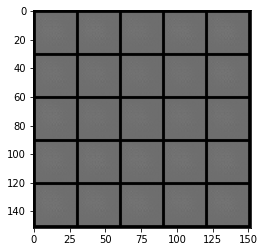

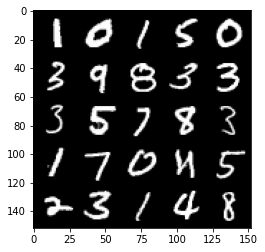

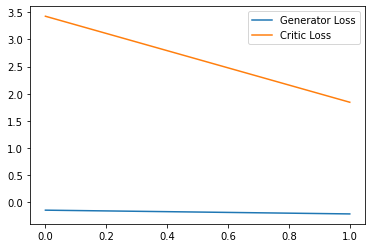

Step 100: Generator loss: 0.5846477055549621, critic loss: -1.4589777092933656


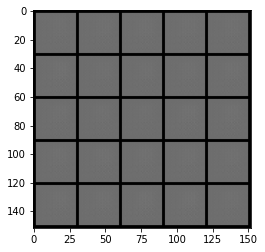

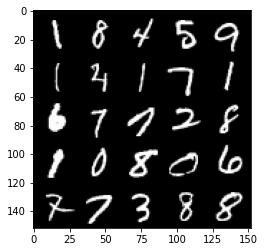

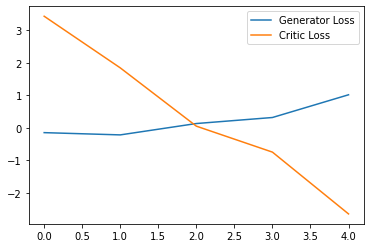

Step 150: Generator loss: 3.288078122138977, critic loss: -11.696846672058104


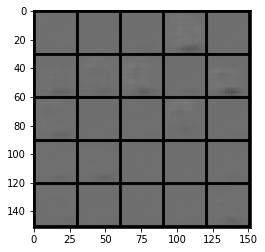

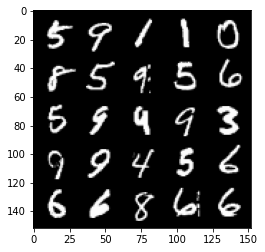

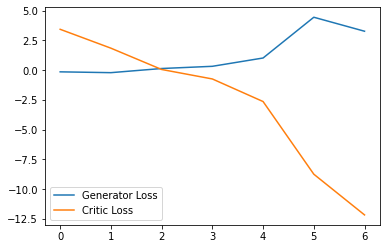

Step 200: Generator loss: -1.0947219747304917, critic loss: -27.500433002471922


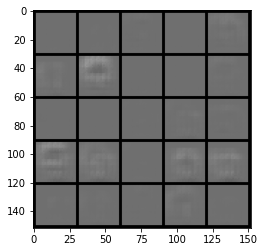

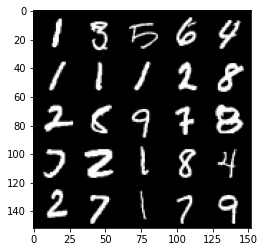

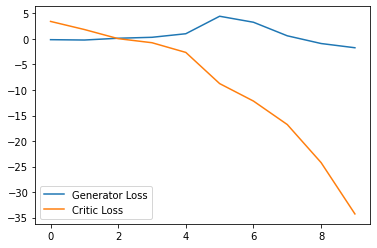

Step 250: Generator loss: -1.8030698569118977, critic loss: -58.27760968017579


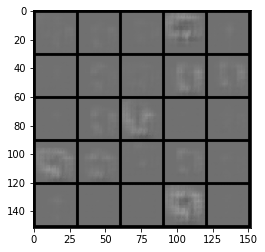

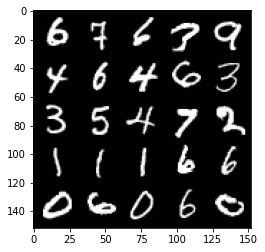

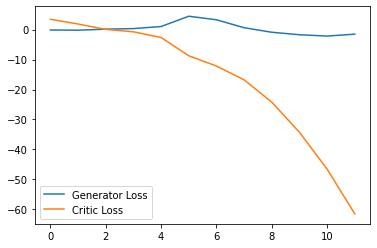

Step 300: Generator loss: -0.7490748381614685, critic loss: -99.94184890747073


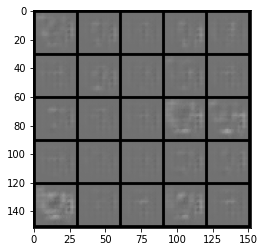

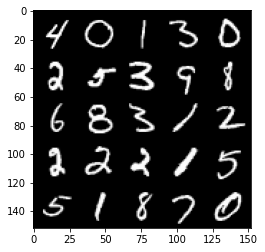

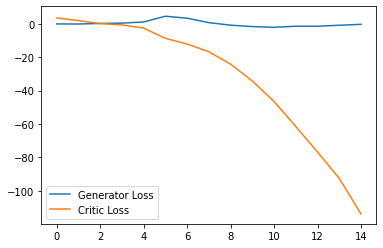

Step 350: Generator loss: 0.9668669721484184, critic loss: -142.44278359985347


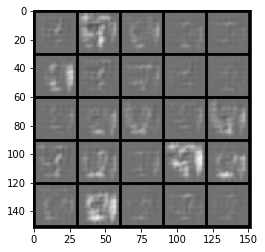

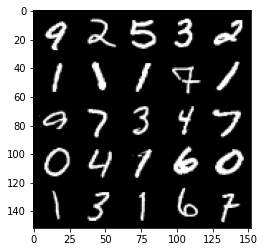

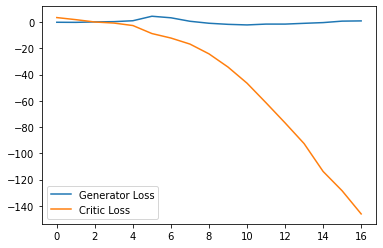

Step 400: Generator loss: 2.5398158183693886, critic loss: -197.74169024658207


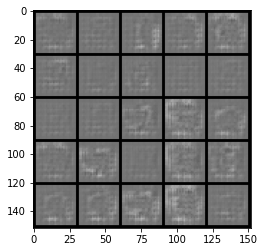

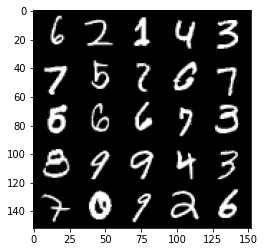

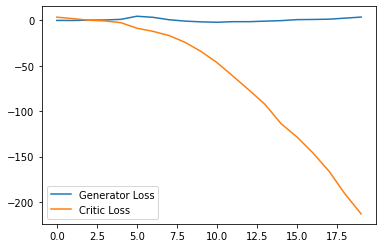

Step 450: Generator loss: 6.102408865094185, critic loss: -247.10324202346797


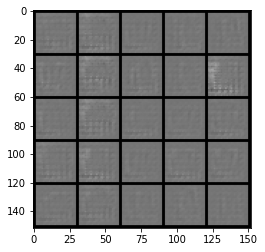

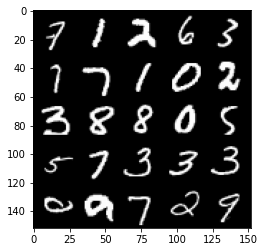

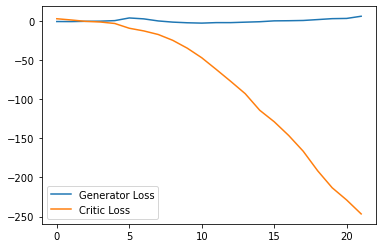

Step 500: Generator loss: 14.52042778968811, critic loss: -313.1963939819335


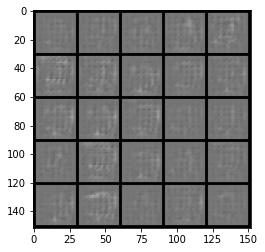

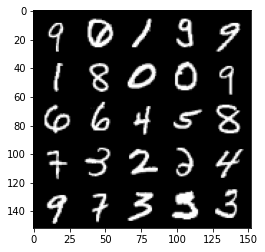

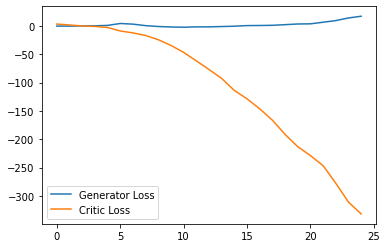

Step 550: Generator loss: -4.535058927536011, critic loss: -286.42414184570316


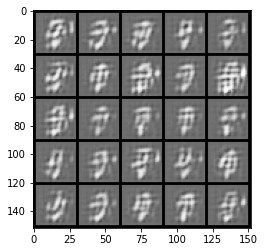

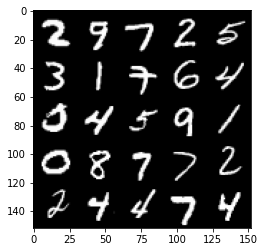

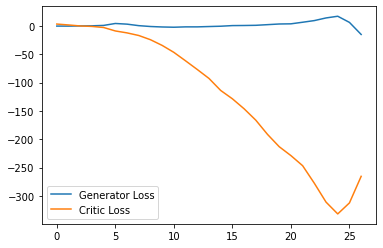

Step 600: Generator loss: 26.65147846341133, critic loss: -334.6204303588867


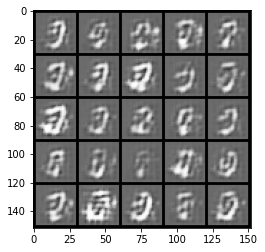

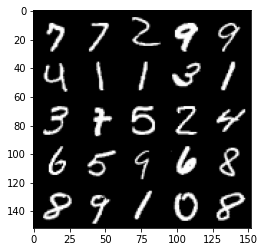

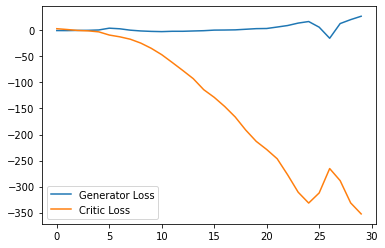

Step 650: Generator loss: 8.344965529441833, critic loss: -353.3552555541992


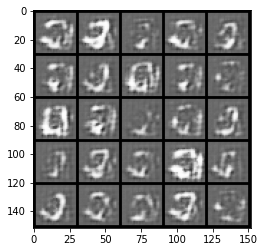

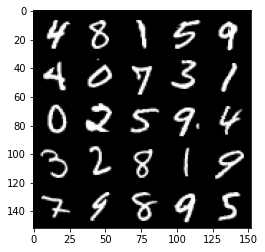

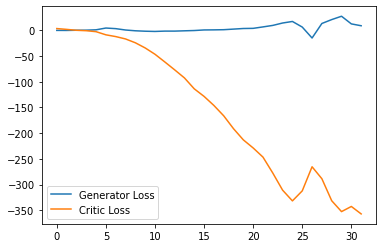

Step 700: Generator loss: 1.3124874943494798, critic loss: -360.5841175537109


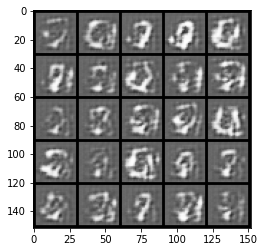

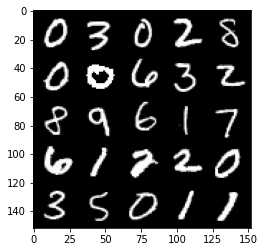

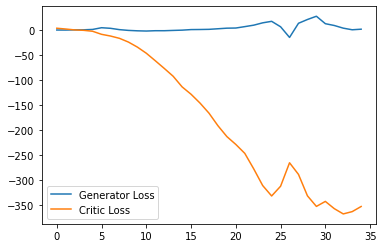

Step 750: Generator loss: -26.852821354866027, critic loss: -289.59906298828133


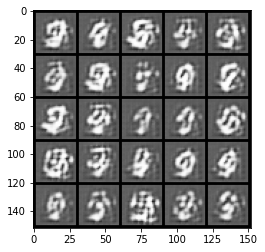

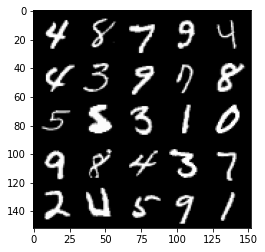

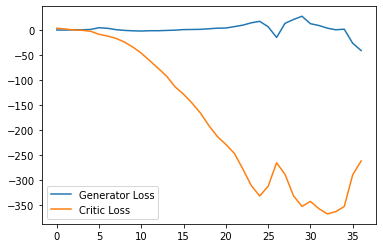

Step 800: Generator loss: -10.191072687506676, critic loss: -150.8412888183594


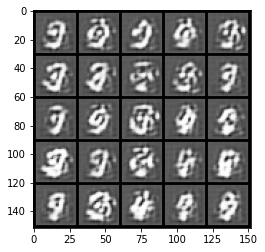

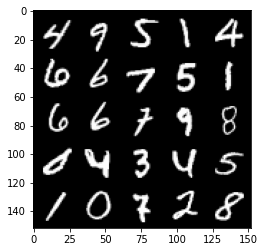

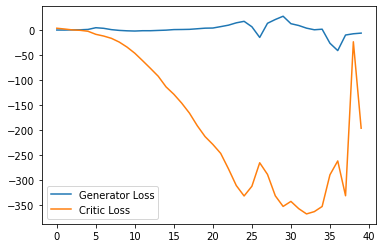

Step 850: Generator loss: -25.39054141044617, critic loss: -206.83422712707522


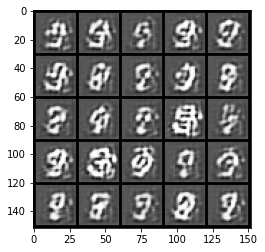

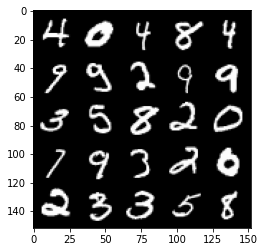

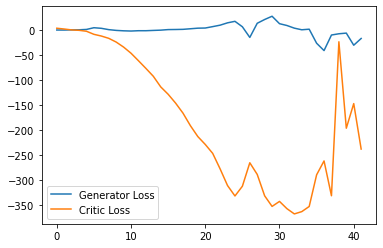

Step 900: Generator loss: -54.193674392700196, critic loss: -210.54670840454102


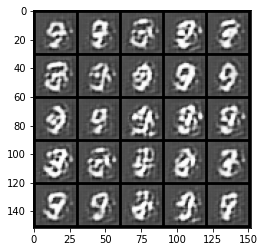

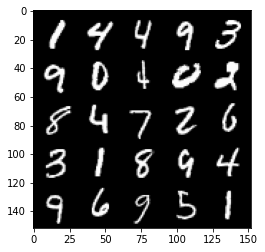

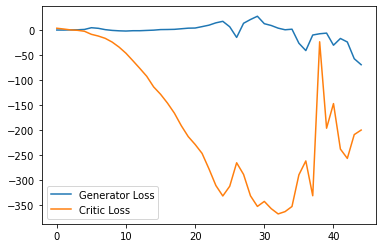

Step 950: Generator loss: -28.16642825126648, critic loss: -160.3499128417969


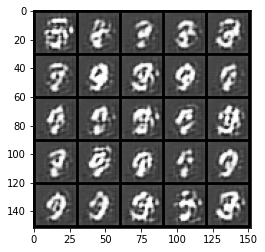

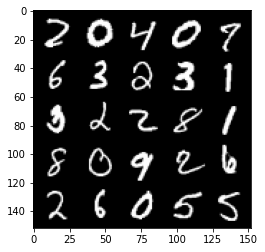

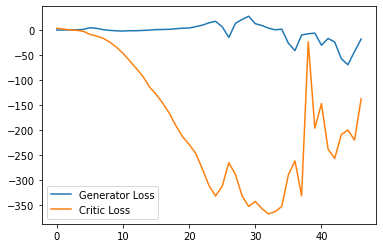

Step 1000: Generator loss: -44.35861012041569, critic loss: -155.99758711242674


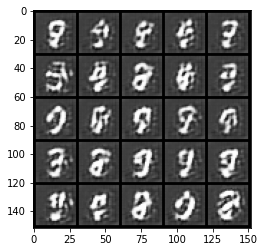

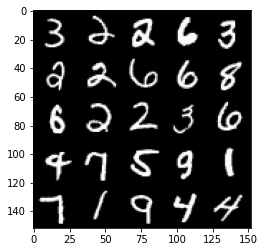

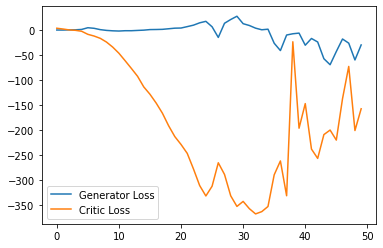

Step 1050: Generator loss: -5.774491300582886, critic loss: -30.20213912963868


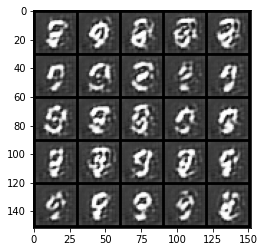

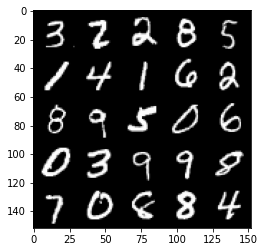

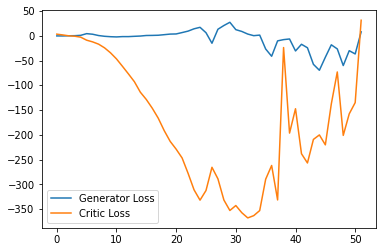

Step 1100: Generator loss: 10.616620111465455, critic loss: 13.35425424957276


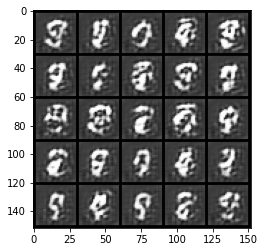

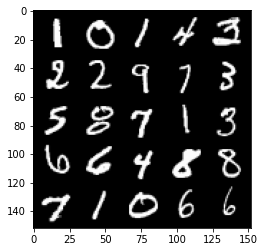

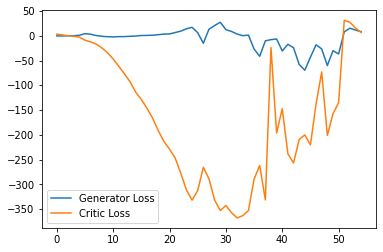

Step 1150: Generator loss: -10.488871926963329, critic loss: -37.4717615814209


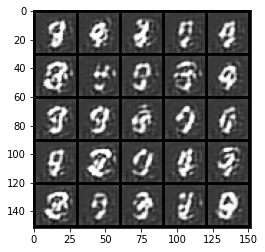

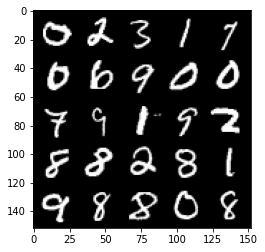

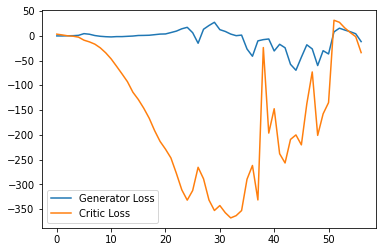

Step 1200: Generator loss: -43.042065706253055, critic loss: -126.0385986328125


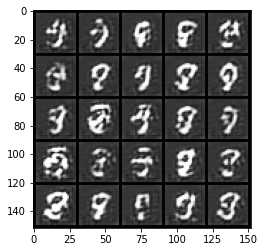

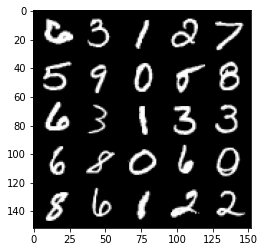

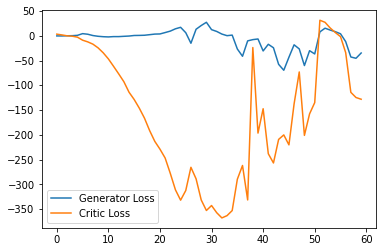

Step 1250: Generator loss: -35.185218596458434, critic loss: -81.4254961090088


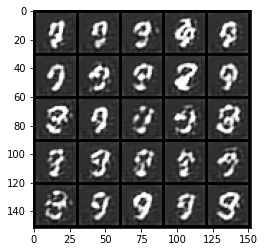

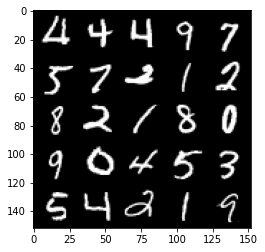

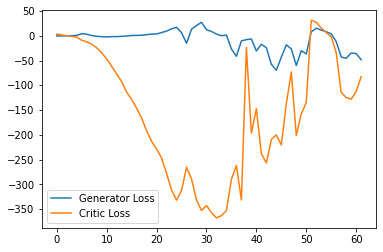

Step 1300: Generator loss: -10.902871873229742, critic loss: 9.118383781433106


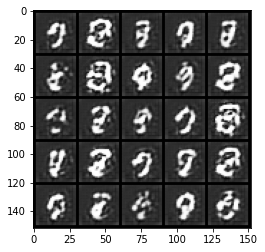

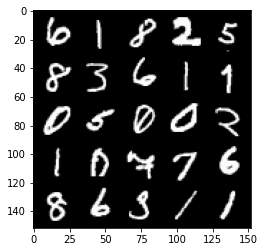

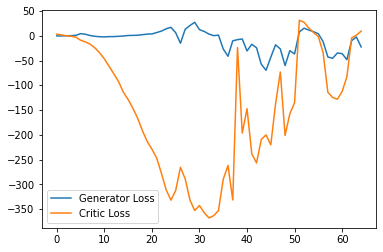

Step 1350: Generator loss: -1.835280966758728, critic loss: 22.153988868713377


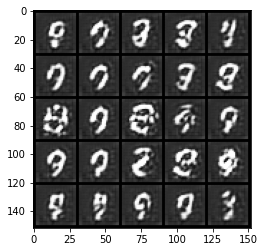

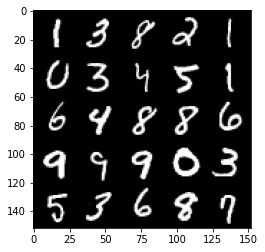

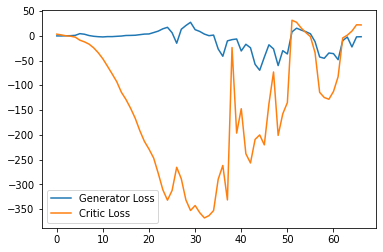

Step 1400: Generator loss: -2.3475501799583434, critic loss: 21.875758079528808


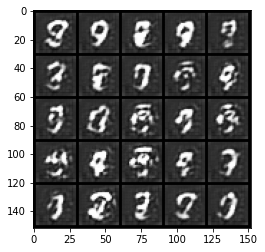

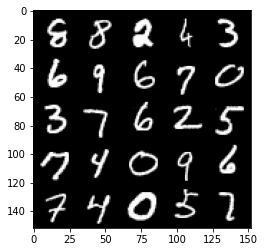

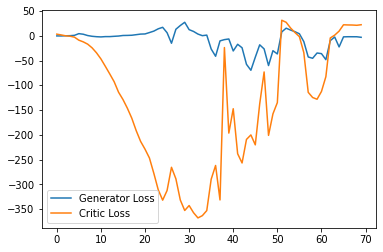

Step 1450: Generator loss: -4.9782184219360355, critic loss: 24.537410812377928


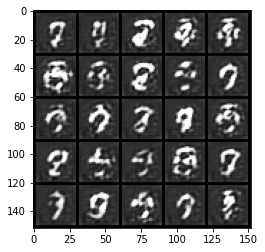

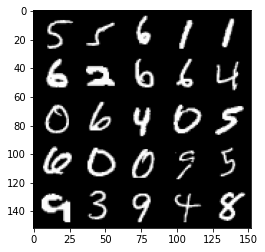

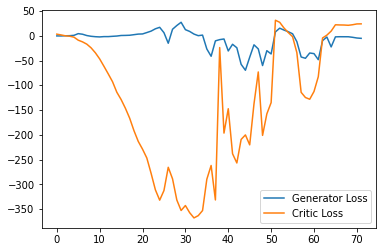

Step 1500: Generator loss: -7.12813021659851, critic loss: 29.29262526702882


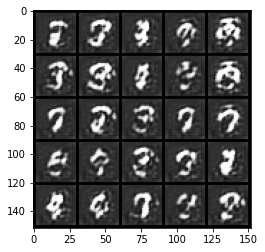

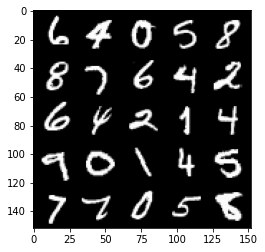

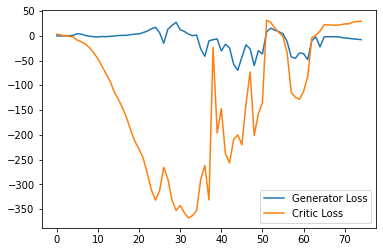

Step 1550: Generator loss: -8.219176254272462, critic loss: 30.462712120056143


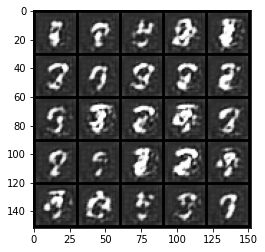

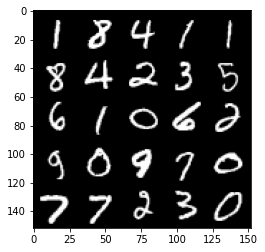

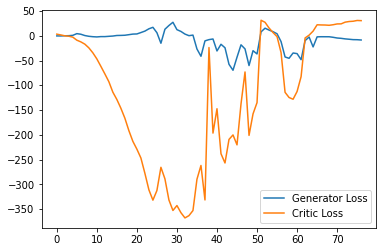

Step 1600: Generator loss: -9.445889377593994, critic loss: 25.904195392608635


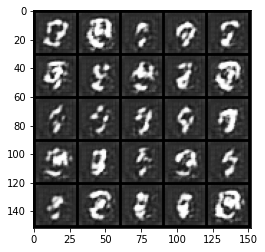

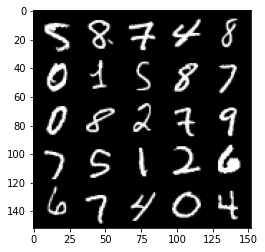

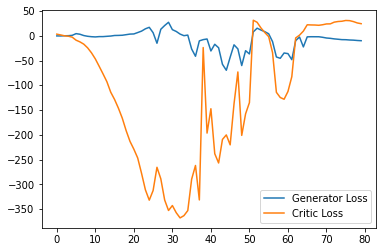

Step 1650: Generator loss: -10.475281581878662, critic loss: 21.07909482192992


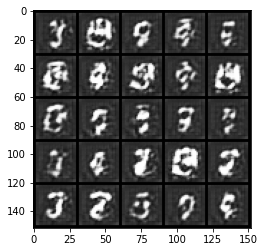

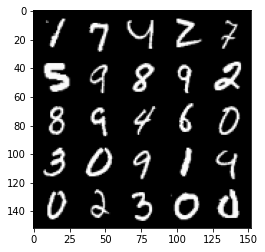

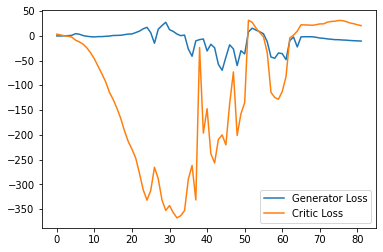

Step 1700: Generator loss: -11.437938175201417, critic loss: 17.02163306427002


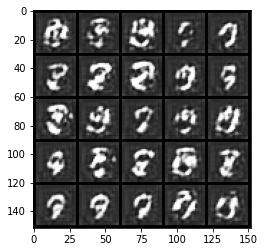

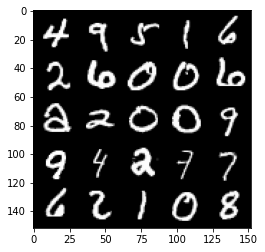

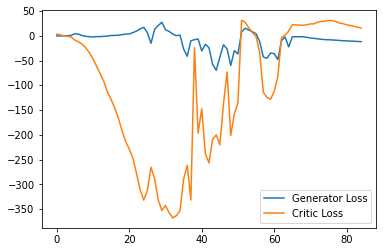

Step 1750: Generator loss: -12.594506568908692, critic loss: 13.050428428649905


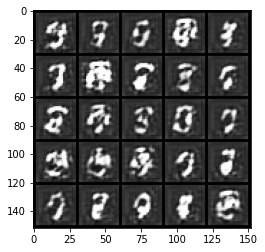

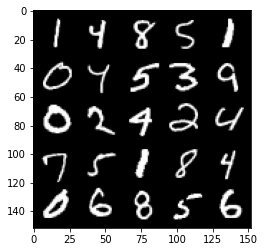

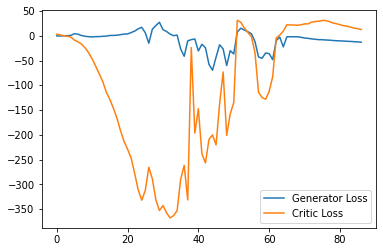

Step 1800: Generator loss: -11.846786308288575, critic loss: 7.877534763336183


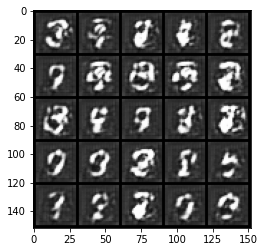

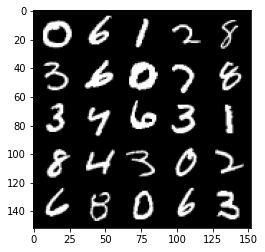

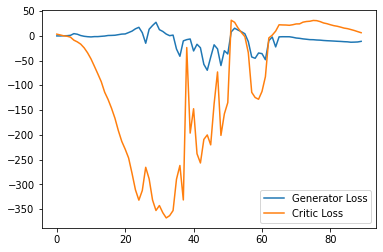

Step 1850: Generator loss: -9.756099281311036, critic loss: 3.712642652511596


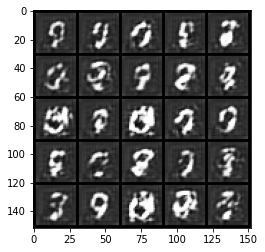

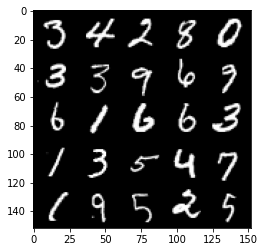

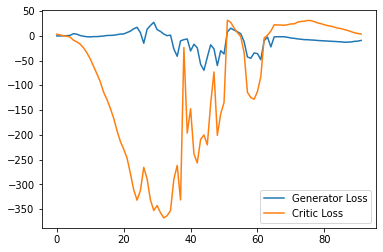

Step 1900: Generator loss: -6.883578472137451, critic loss: -0.2164398956298829


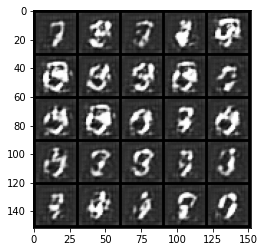

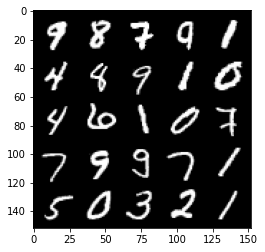

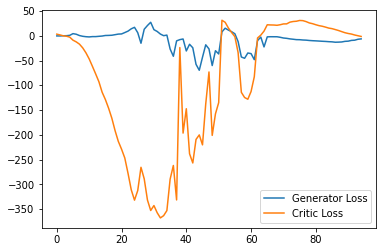

Step 1950: Generator loss: -3.8379568585753443, critic loss: -3.1652075138092046


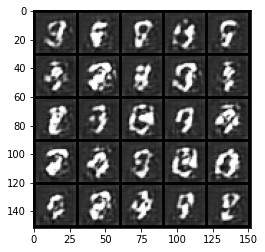

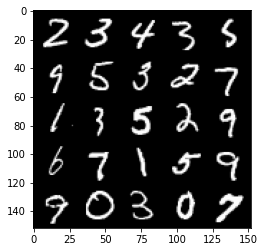

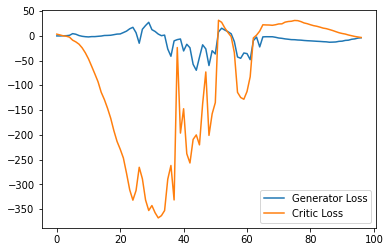

Step 2000: Generator loss: -0.8964548566937447, critic loss: -6.689284091949462


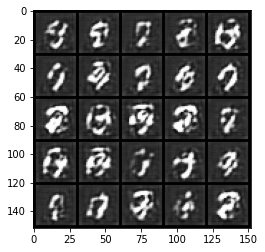

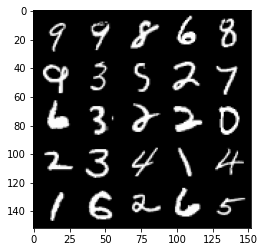

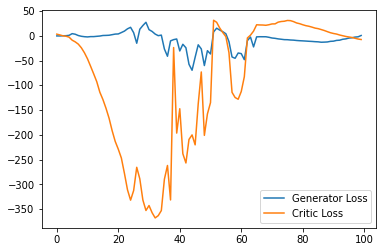

Step 2050: Generator loss: 2.5378104028105737, critic loss: -9.593145845413208


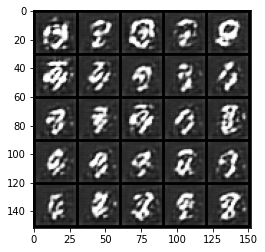

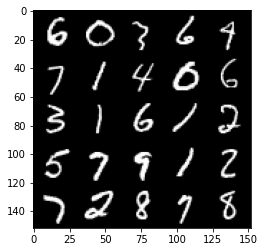

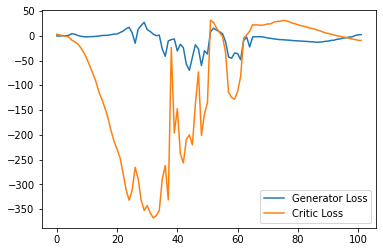

Step 2100: Generator loss: 4.483616614937782, critic loss: -14.37828336715698


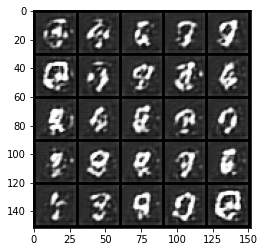

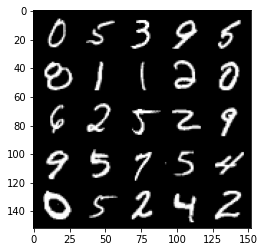

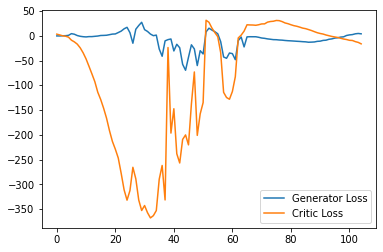

Step 2150: Generator loss: 8.5964324760437, critic loss: -18.316293642044066


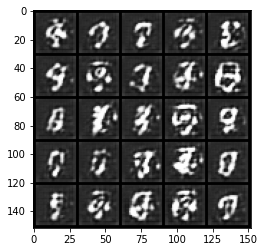

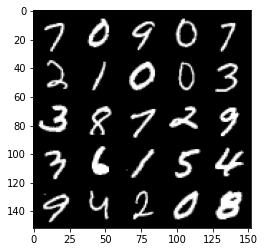

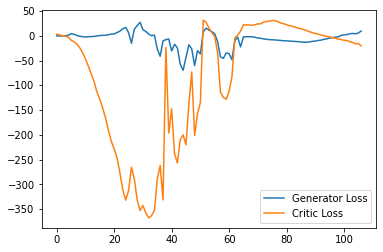

Step 2200: Generator loss: 6.6146456813812256, critic loss: -10.557986070632936


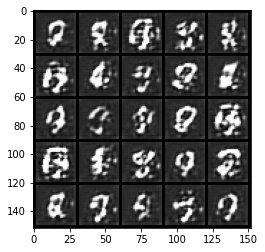

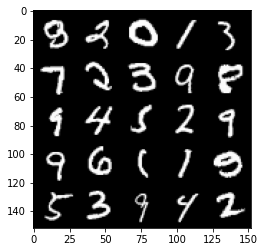

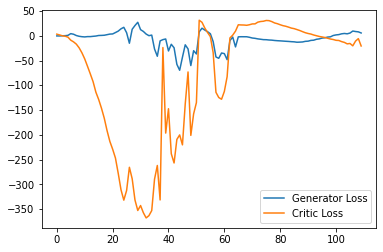

Step 2250: Generator loss: 9.593437356948852, critic loss: -23.43520902252198


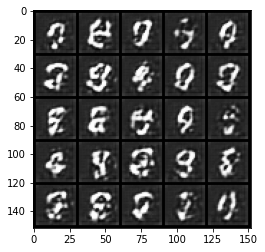

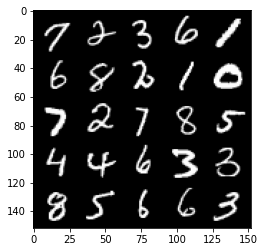

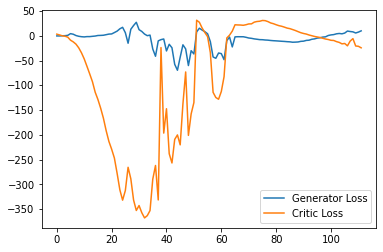

Step 2300: Generator loss: 9.87604945898056, critic loss: -19.837897232055667


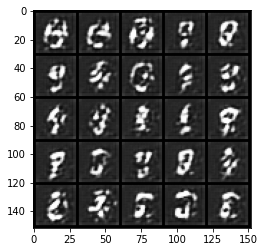

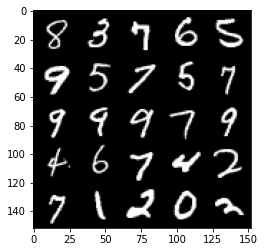

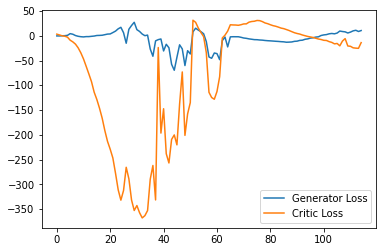

Step 2350: Generator loss: 9.387905149459838, critic loss: -2.8625903296470643


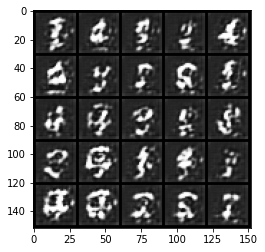

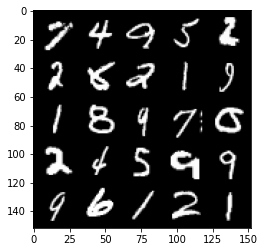

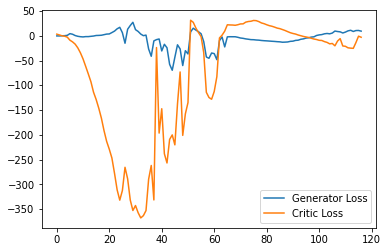

Step 2400: Generator loss: 1.5536567199230193, critic loss: -20.83148470306397


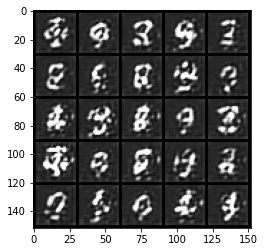

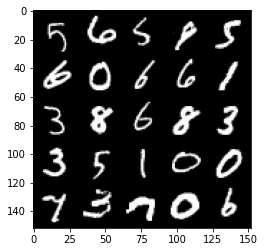

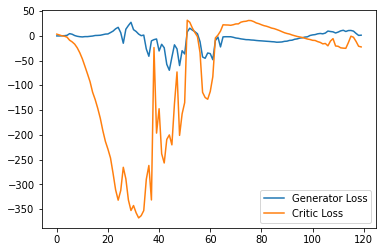

Step 2450: Generator loss: 4.747753999531269, critic loss: -25.11092297744751


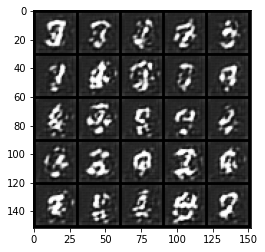

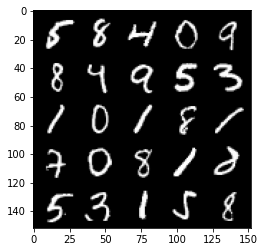

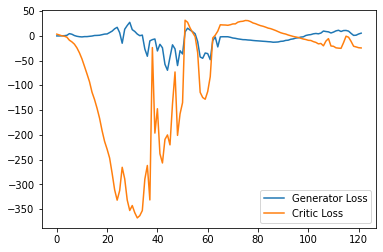

Step 2500: Generator loss: 7.492283656597137, critic loss: -23.58442092514039


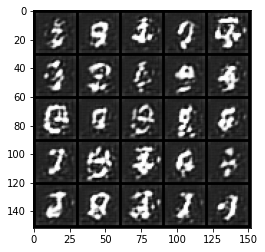

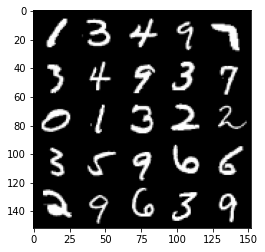

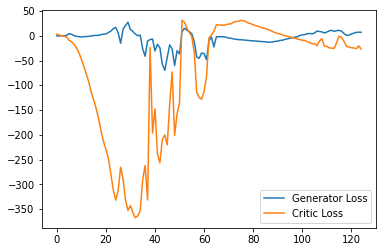

Step 2550: Generator loss: 5.8649344652891156, critic loss: -27.851842090606674


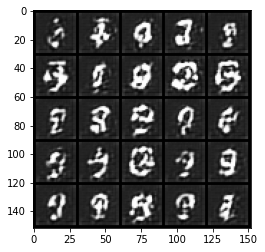

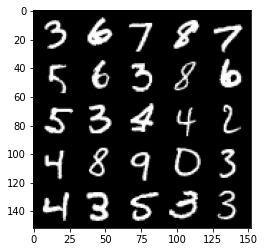

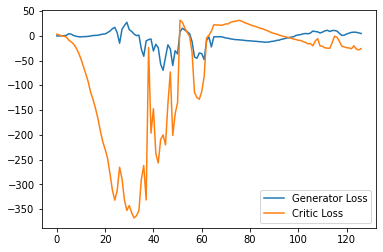

Step 2600: Generator loss: 8.869004628658296, critic loss: -27.524883527755737


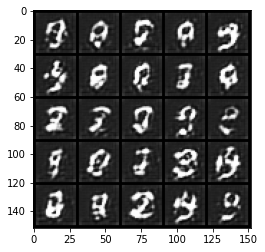

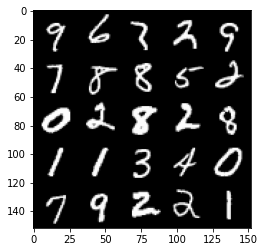

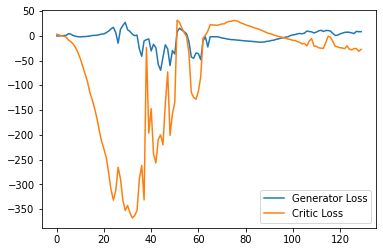

Step 2650: Generator loss: 9.232132215499878, critic loss: -1.3294063963890077


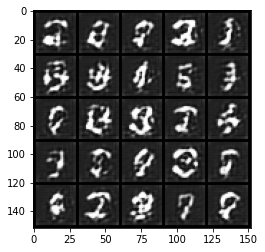

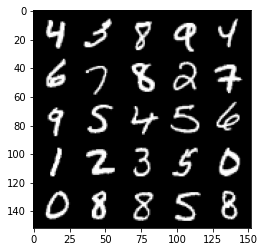

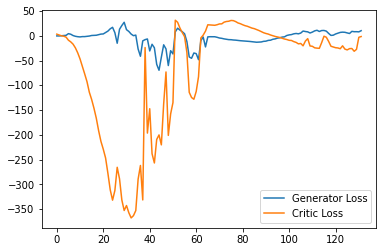

Step 2700: Generator loss: 6.1017611837387085, critic loss: -1.1801377835273745


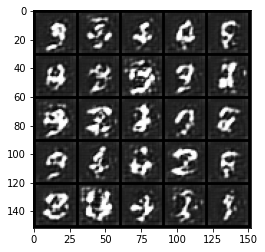

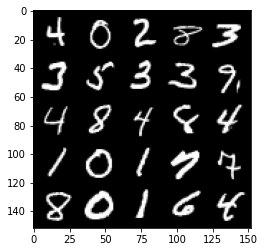

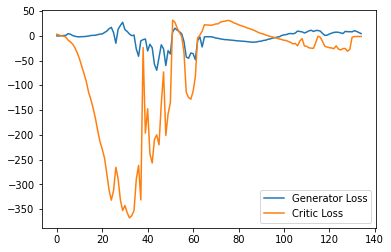

Step 2750: Generator loss: 2.6877147793769836, critic loss: -3.5524661140441895


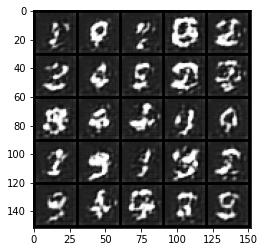

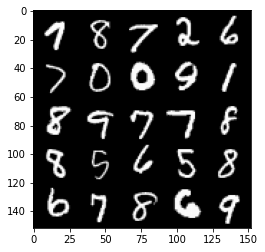

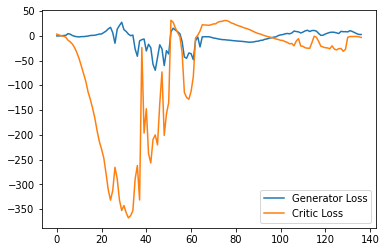

Step 2800: Generator loss: -0.7576012563705444, critic loss: -25.23579475593567


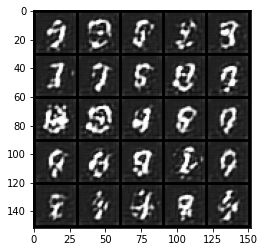

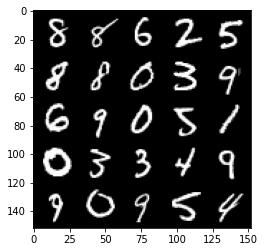

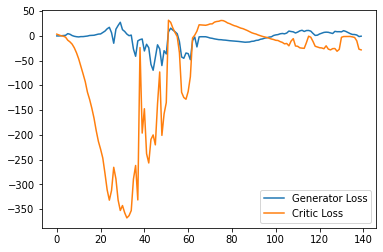

Step 2850: Generator loss: 2.9335242649912834, critic loss: -28.961288053512575


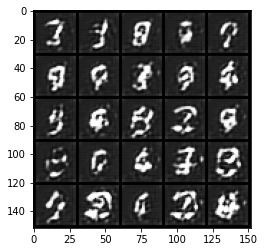

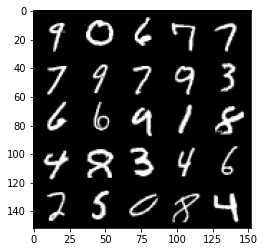

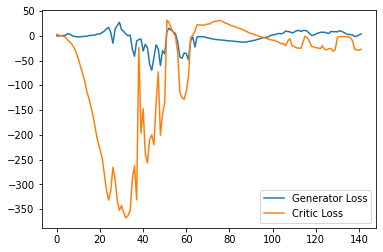

Step 2900: Generator loss: 4.062493026852608, critic loss: -29.799606445312502


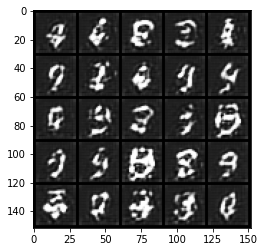

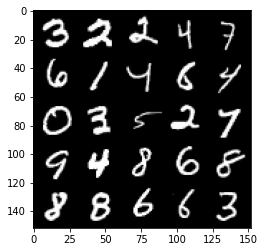

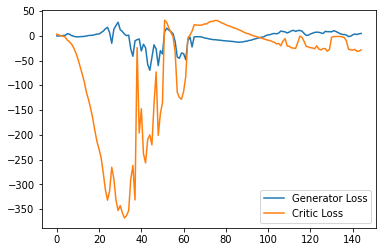

Step 2950: Generator loss: 4.337307018041611, critic loss: -30.471844215393077


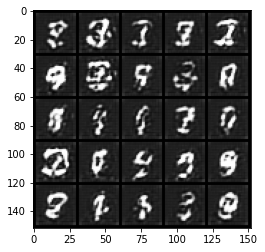

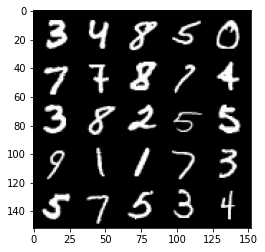

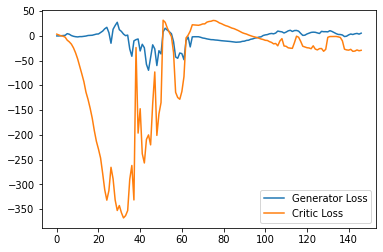

Step 3000: Generator loss: 3.6452756345272066, critic loss: -31.32305718612671


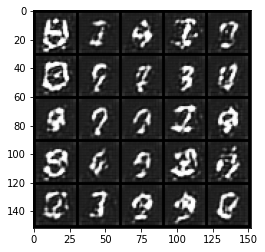

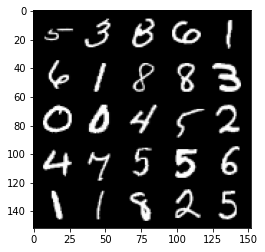

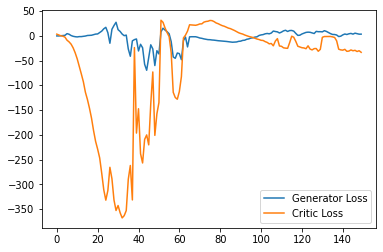

Step 3050: Generator loss: 4.3964228916168215, critic loss: -30.361368169784544


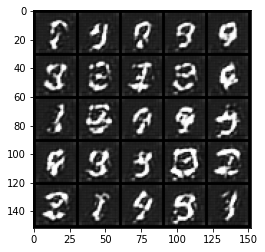

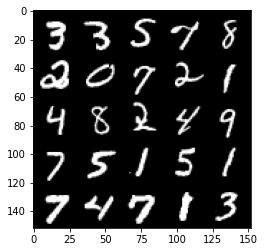

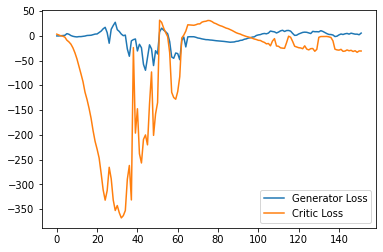

Step 3100: Generator loss: 4.130638589859009, critic loss: -31.237019914627073


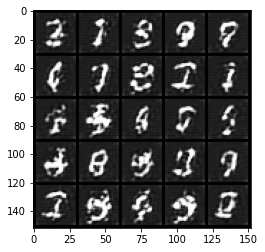

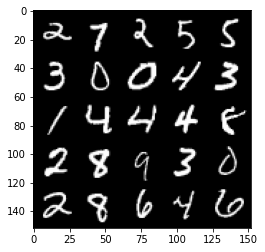

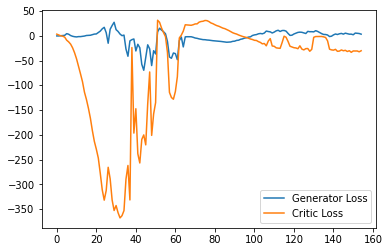

Step 3150: Generator loss: 4.203303087055684, critic loss: -34.83802219581605


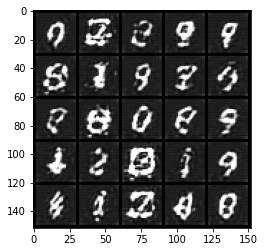

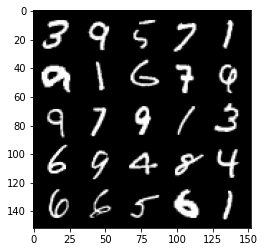

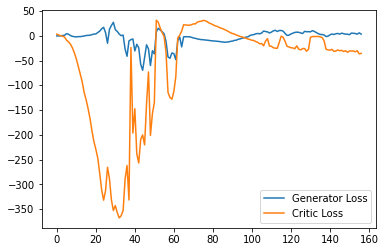

Step 3200: Generator loss: 3.770210764110088, critic loss: -29.77882237243653


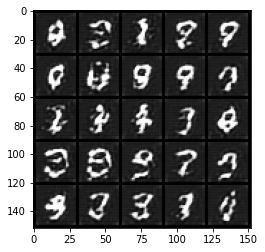

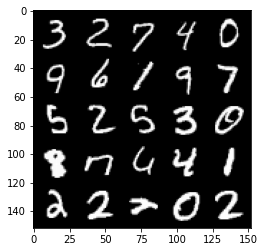

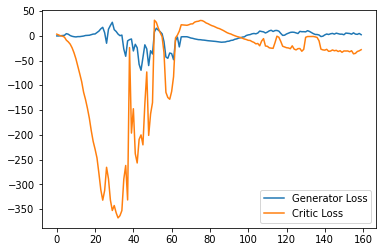

Step 3250: Generator loss: 5.0458316814154385, critic loss: -31.03089353656769


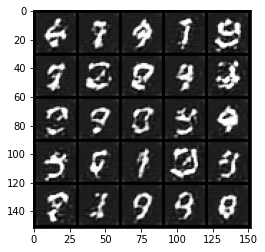

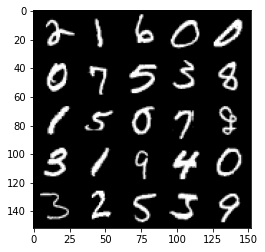

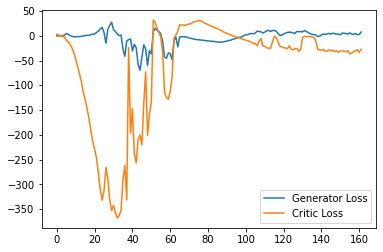

Step 3300: Generator loss: 8.382102403640747, critic loss: -23.829476321220394


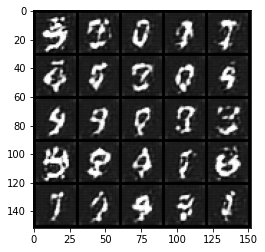

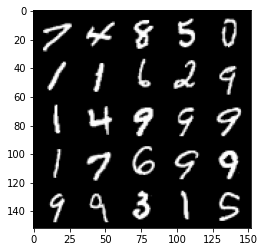

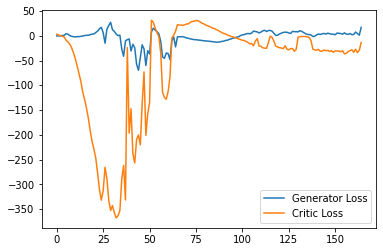

Step 3350: Generator loss: 4.8195456743240355, critic loss: -29.796477688789377


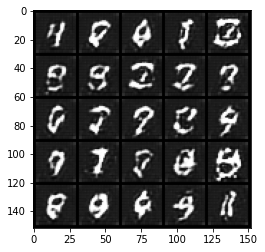

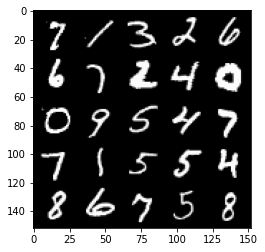

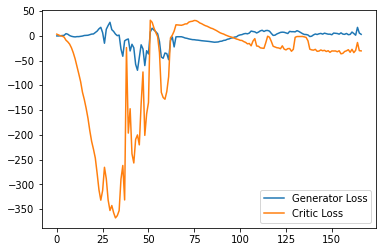

Step 3400: Generator loss: 5.617031497359275, critic loss: -25.68217937469482


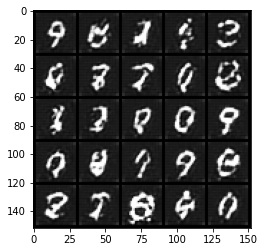

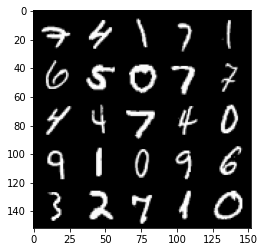

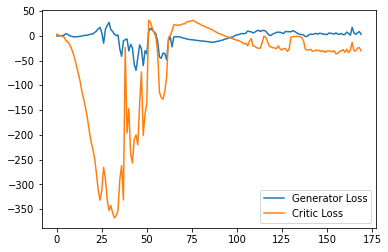

Step 3450: Generator loss: 7.091178694069385, critic loss: -25.6742585887909


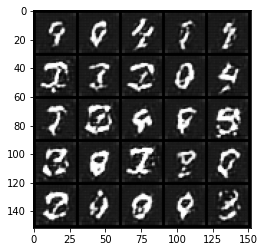

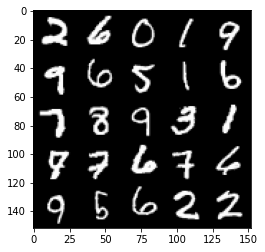

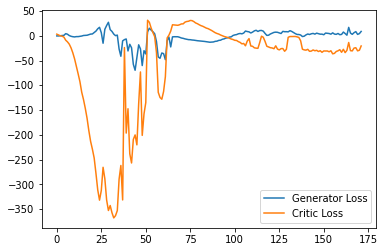

Step 3500: Generator loss: 4.2295294439792634, critic loss: -30.166954602241514


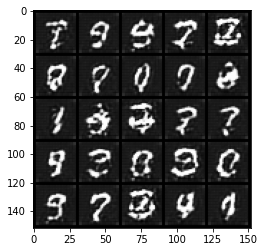

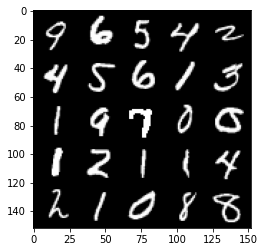

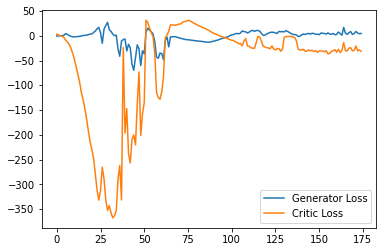

Step 3550: Generator loss: 8.00963078737259, critic loss: -21.837667604446406


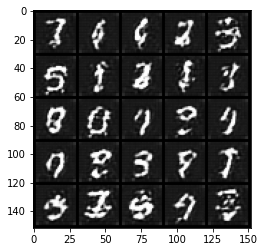

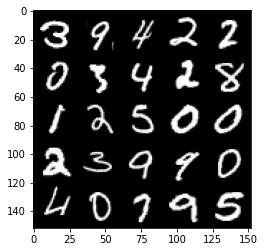

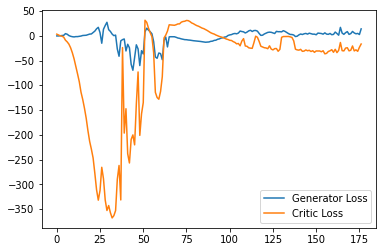

Step 3600: Generator loss: 15.675489583015441, critic loss: -2.2908035383224488


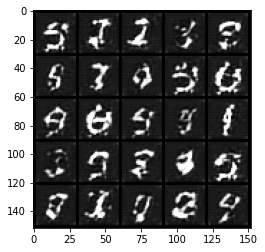

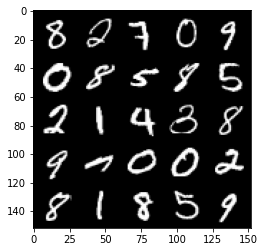

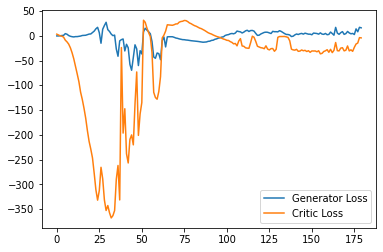

Step 3650: Generator loss: 5.411725702136755, critic loss: -23.026979203224183


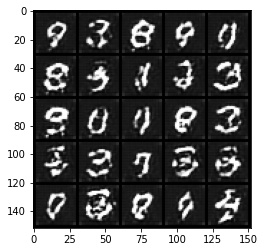

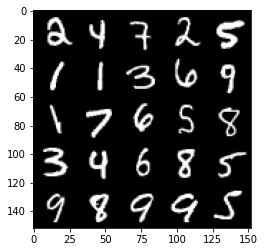

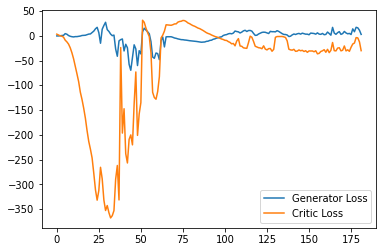

Step 3700: Generator loss: 5.374527038484811, critic loss: -19.29904006910323


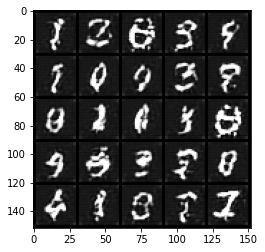

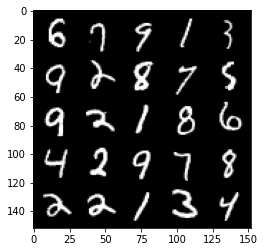

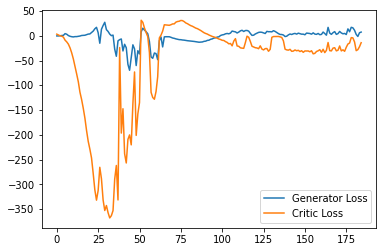

Step 3750: Generator loss: 17.276742897033692, critic loss: -2.5445434899330137


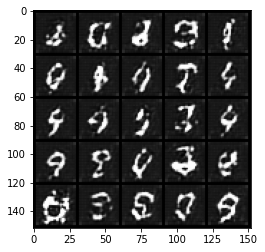

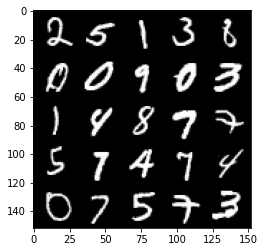

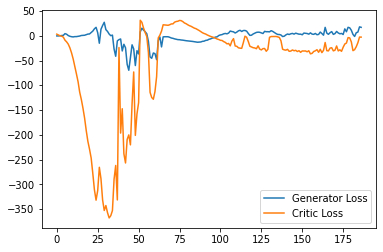

Step 3800: Generator loss: 15.021694679260253, critic loss: -2.915739076137543


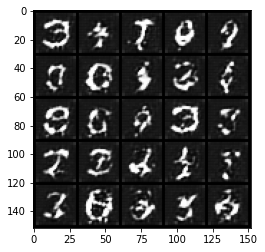

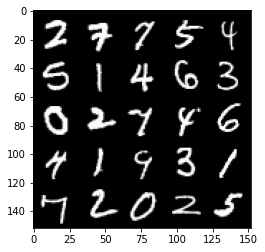

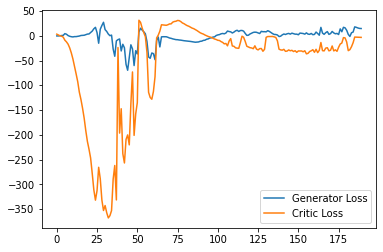

Step 3850: Generator loss: 13.07416301727295, critic loss: -5.453337505340576


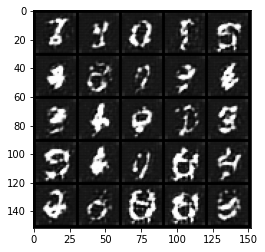

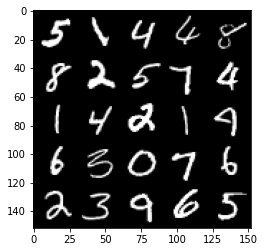

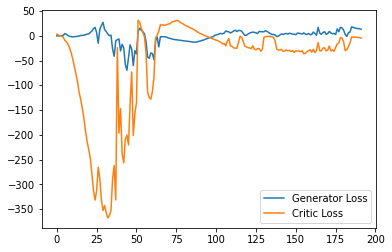

Step 3900: Generator loss: 9.656357224732638, critic loss: -11.212317564010624


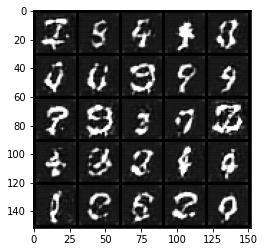

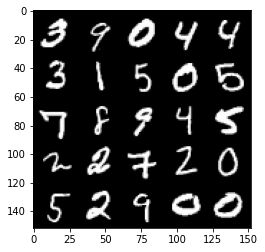

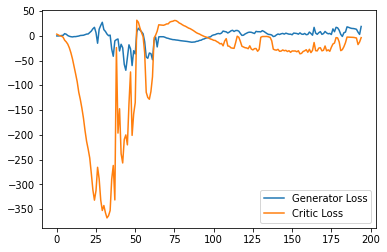

Step 3950: Generator loss: 13.767495539188385, critic loss: -10.207456197738646


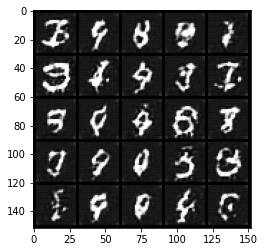

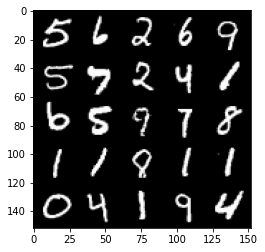

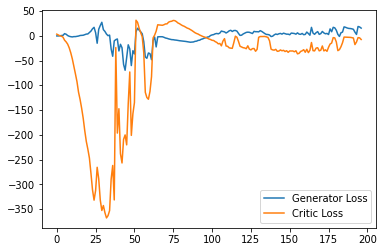

Step 4000: Generator loss: 7.4244095540046695, critic loss: -19.41813949871063


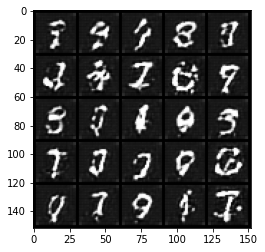

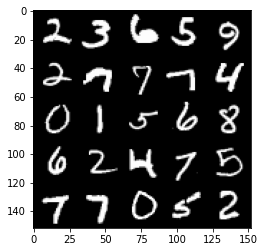

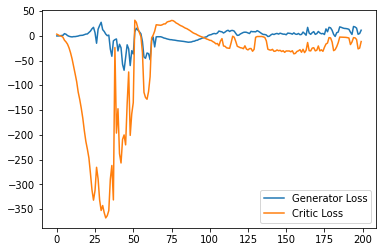

Step 4050: Generator loss: 13.491263523101807, critic loss: -14.405250683784484


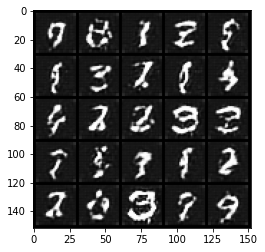

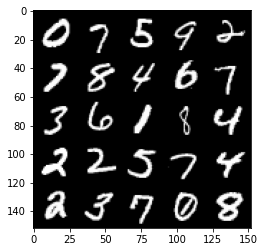

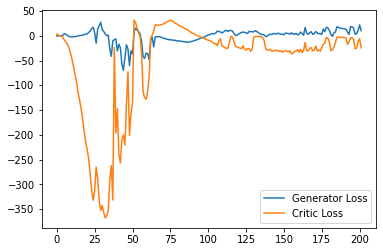

Step 4100: Generator loss: 20.88763786315918, critic loss: -2.889370542526245


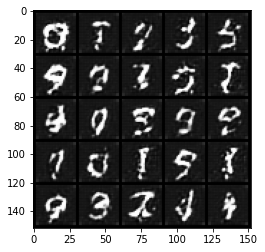

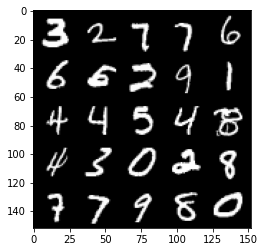

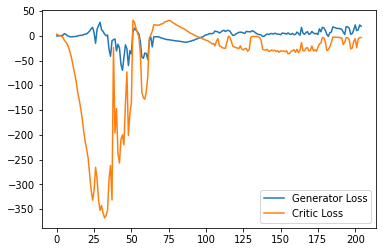

Step 4150: Generator loss: 10.73259064644575, critic loss: -16.845525356292725


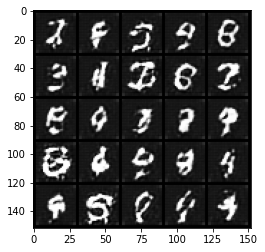

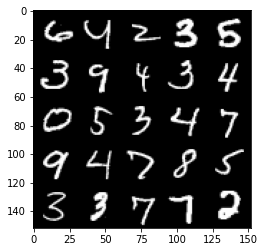

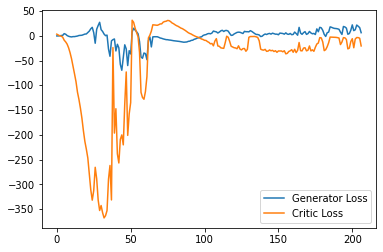

Step 4200: Generator loss: 7.267287077903748, critic loss: -24.73316508674621


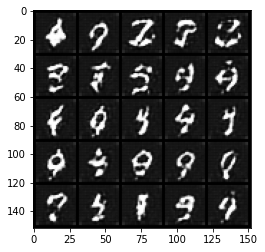

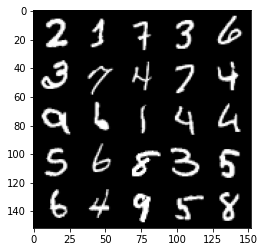

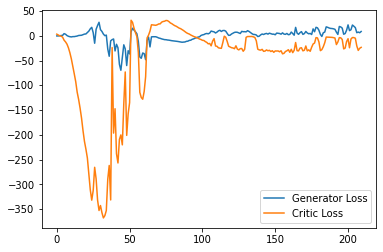

Step 4250: Generator loss: 13.402733035087586, critic loss: -20.10679795646668


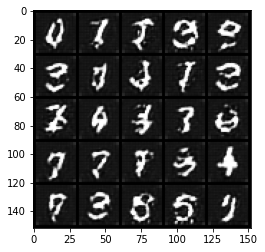

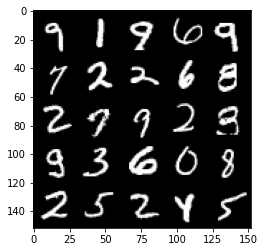

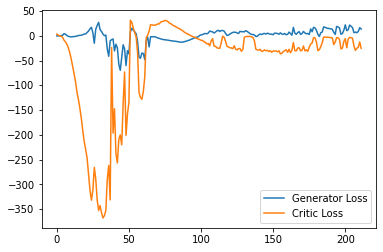

Step 4300: Generator loss: 21.65014886856079, critic loss: -1.6795241923332214


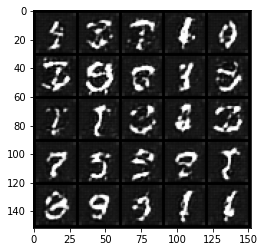

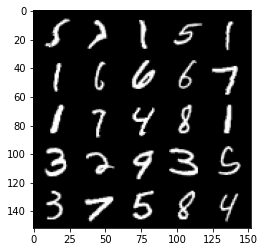

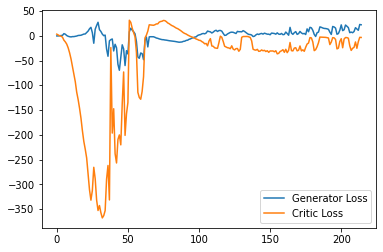

Step 4350: Generator loss: 17.970214223861696, critic loss: -5.750926469802855


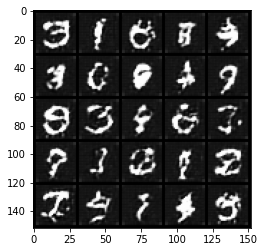

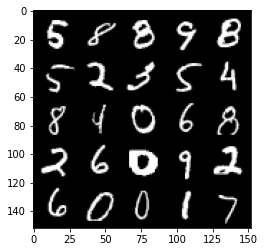

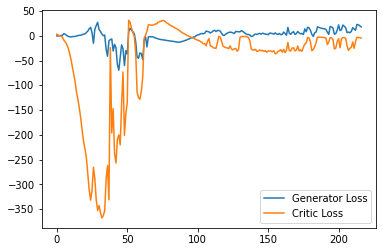

Step 4400: Generator loss: 6.397420374453068, critic loss: -22.31748910522461


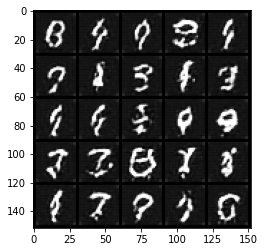

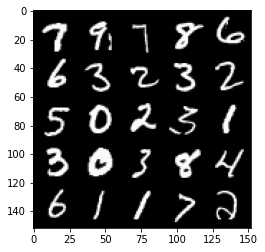

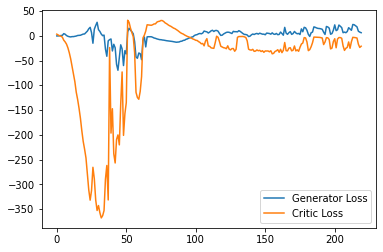

Step 4450: Generator loss: 15.86027623653412, critic loss: -13.508618115425111


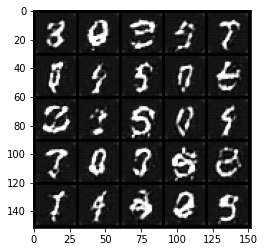

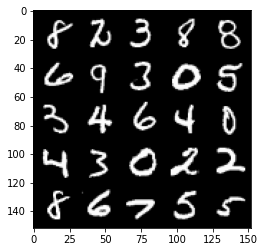

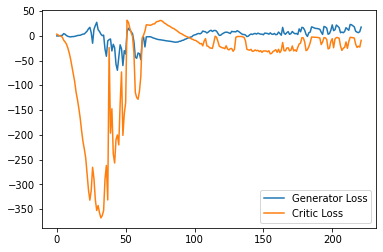

Step 4500: Generator loss: 20.38181266784668, critic loss: -6.851887493133546


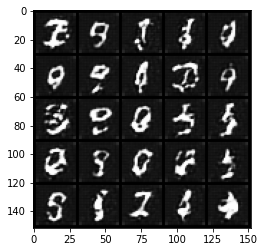

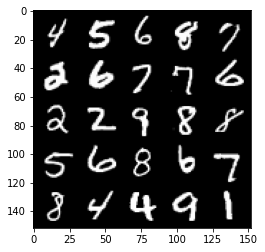

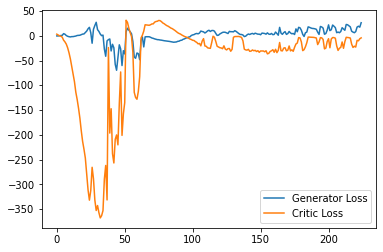

Step 4550: Generator loss: 18.049639406204225, critic loss: -12.625214099884035


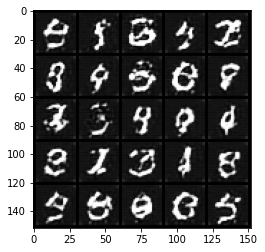

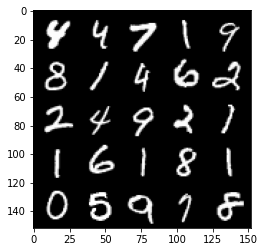

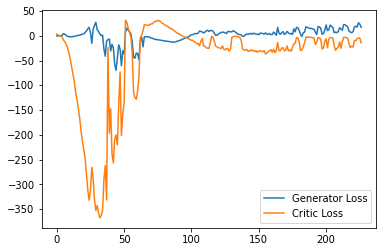

Step 4600: Generator loss: 16.5878546333313, critic loss: -13.619954131603235


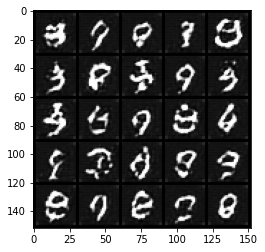

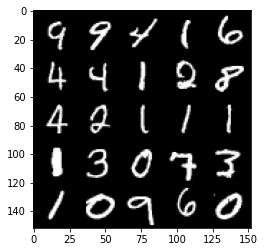

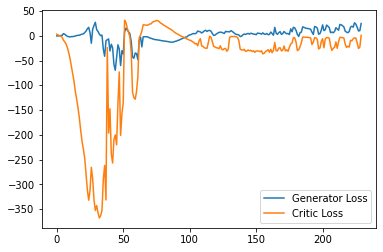

Step 4650: Generator loss: 27.46992458343506, critic loss: -3.54531478023529


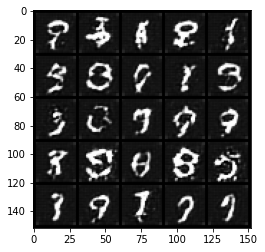

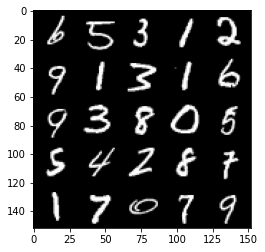

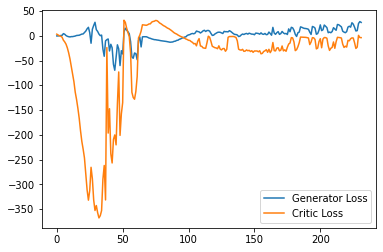

Step 4700: Generator loss: 24.171212997436523, critic loss: -4.953493642807006


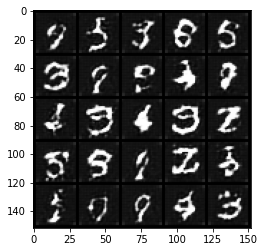

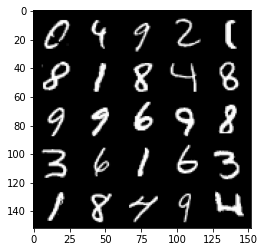

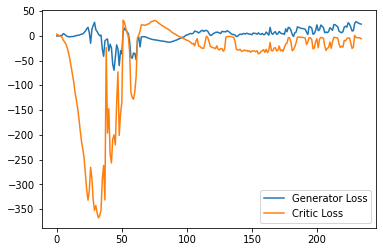

Step 4750: Generator loss: 12.215160245895385, critic loss: -22.80582770729065


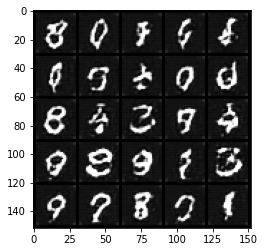

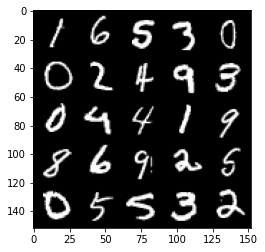

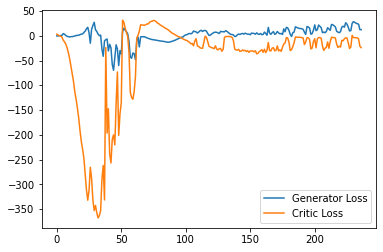

Step 4800: Generator loss: 28.70783091545105, critic loss: -0.4865990939140323


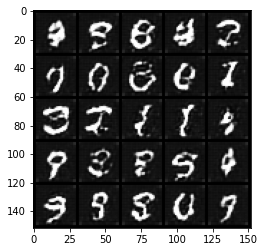

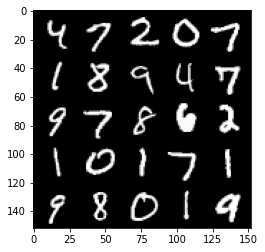

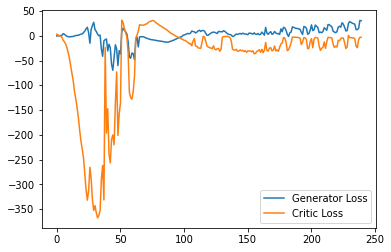

Step 4850: Generator loss: 27.827965507507326, critic loss: -3.032706248283386


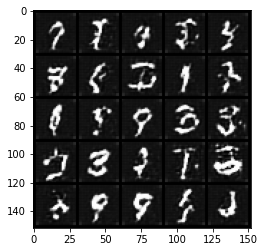

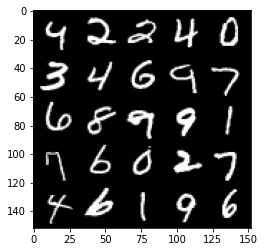

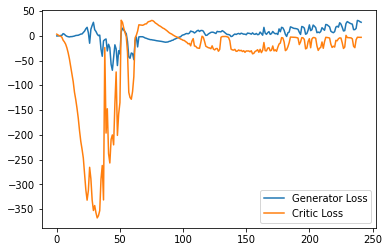

Step 4900: Generator loss: 26.29738269805908, critic loss: -3.2610830049514767


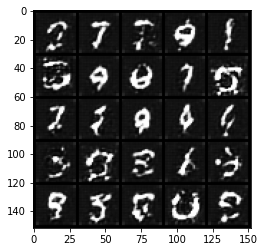

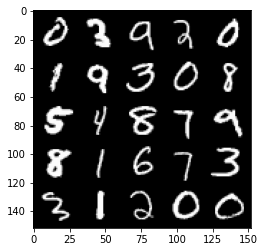

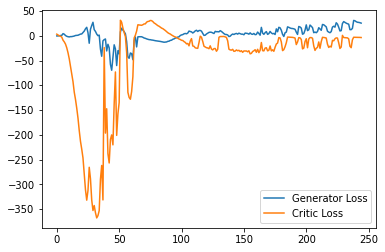

Step 4950: Generator loss: 21.619666423797607, critic loss: -9.553694496154785


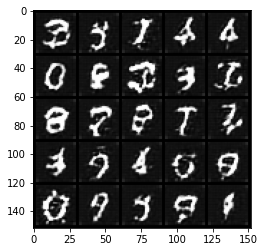

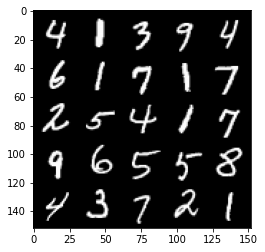

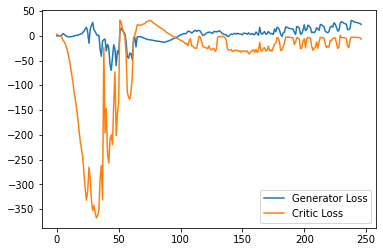

Step 5000: Generator loss: 28.095728282928466, critic loss: 0.8395271344184878


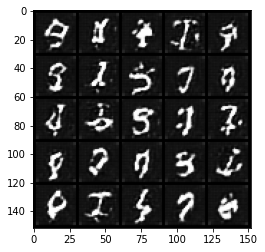

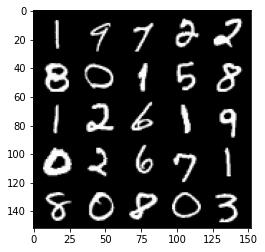

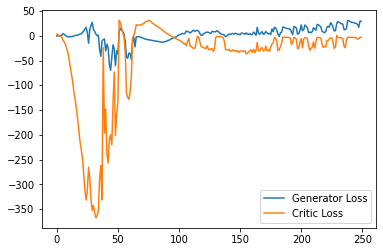

Step 5050: Generator loss: 27.339601097106932, critic loss: -2.996925883293152


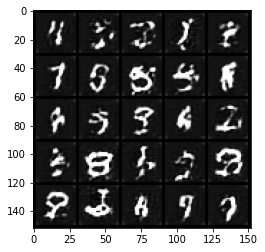

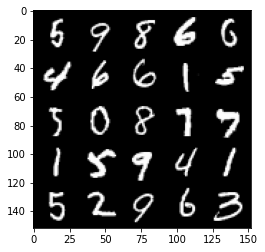

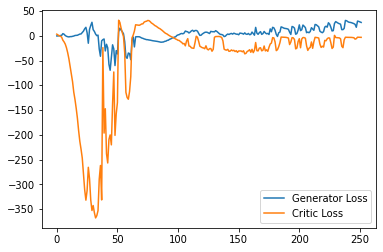

Step 5100: Generator loss: 26.100348815917968, critic loss: -3.114911952018738


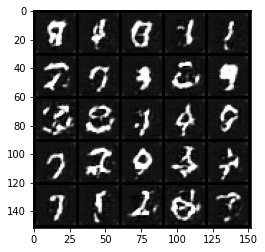

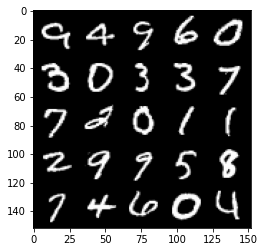

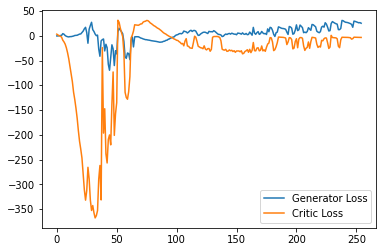

Step 5150: Generator loss: 23.116920394897463, critic loss: -4.917523835182189


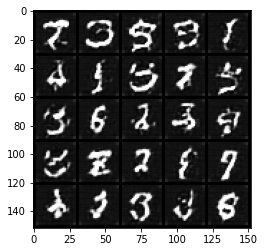

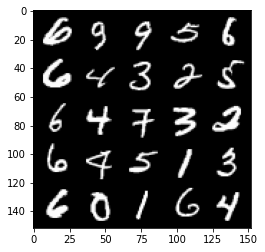

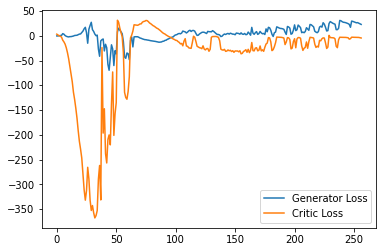

Step 5200: Generator loss: 23.947476043701172, critic loss: -1.6143693213462833


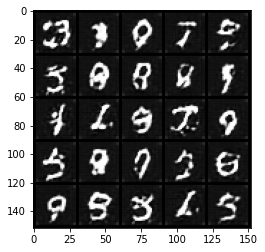

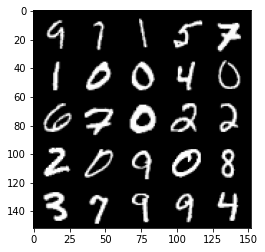

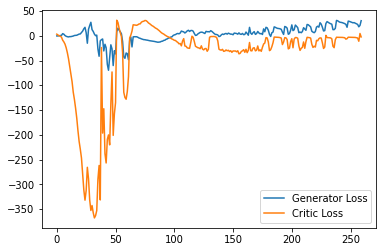

Step 5250: Generator loss: 25.674904975891113, critic loss: -1.8883459467887875


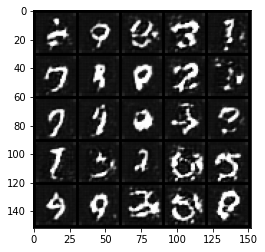

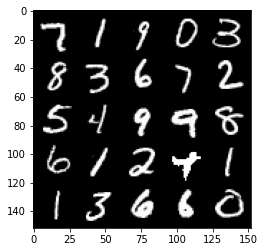

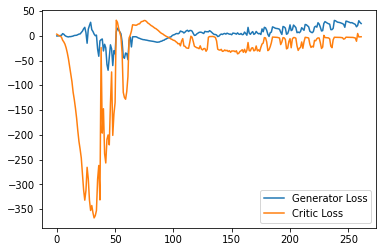

Step 5300: Generator loss: 25.635902099609375, critic loss: -2.0557466721534725


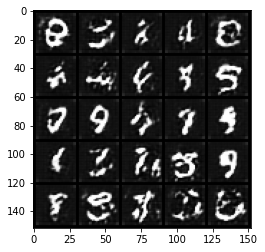

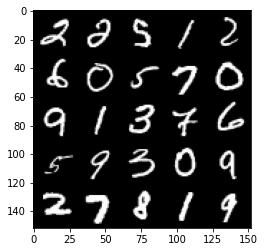

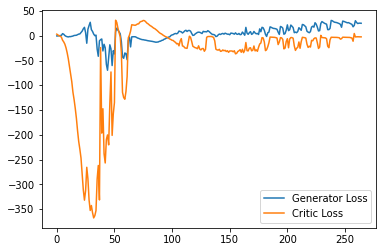

Step 5350: Generator loss: 25.04169853210449, critic loss: -2.199920538902283


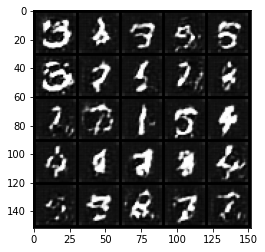

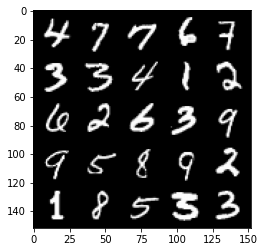

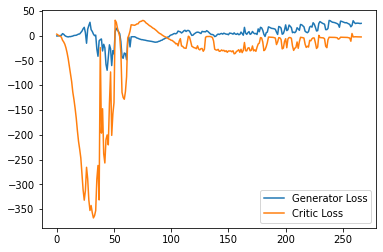

Step 5400: Generator loss: 24.790959358215332, critic loss: -2.5116358284950255


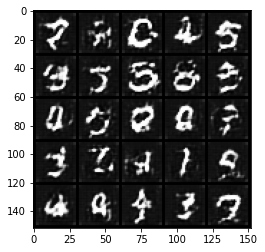

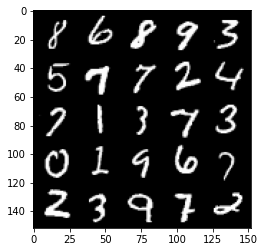

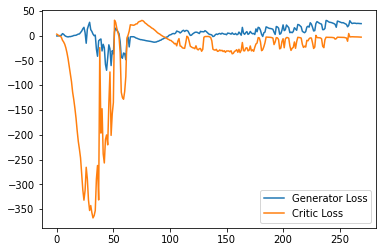

Step 5450: Generator loss: 24.685116996765135, critic loss: -2.9496008696556104


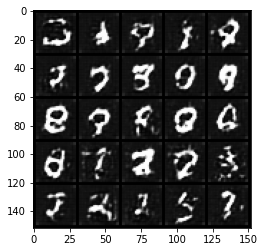

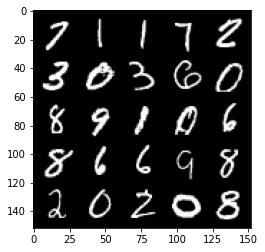

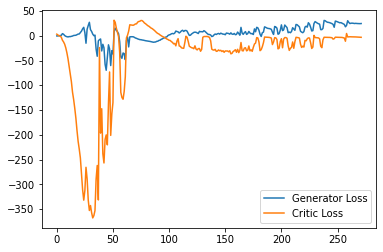

Step 5500: Generator loss: 24.87284580230713, critic loss: -3.7901756963729842


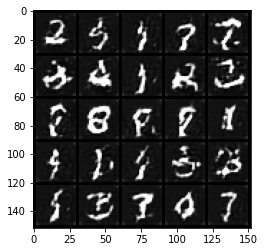

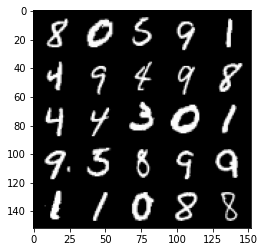

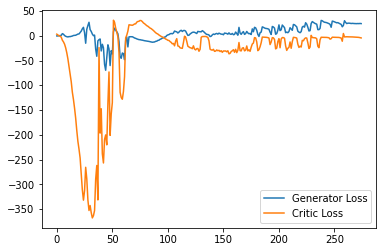

Step 5550: Generator loss: 26.400539321899416, critic loss: -2.470617819309234


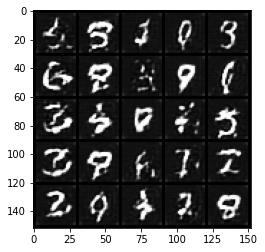

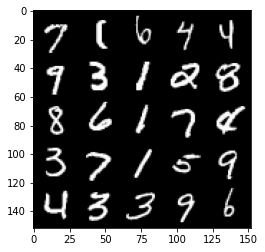

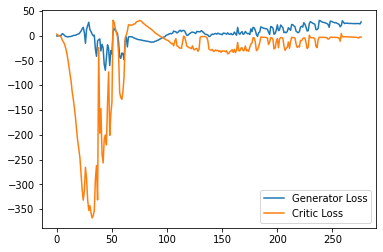

Step 5600: Generator loss: 26.05116182565689, critic loss: -3.6946604242324836


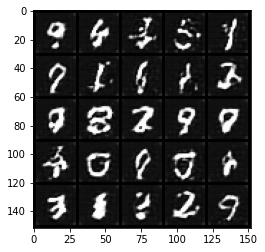

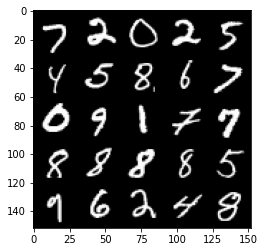

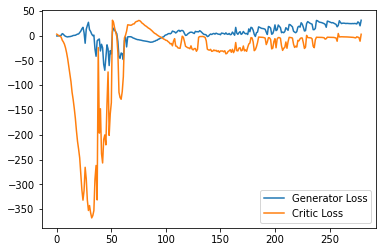

Step 5650: Generator loss: 30.20785774230957, critic loss: -2.4022140173912048


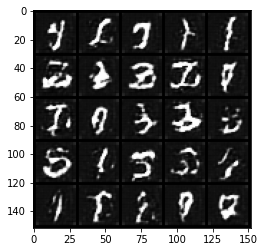

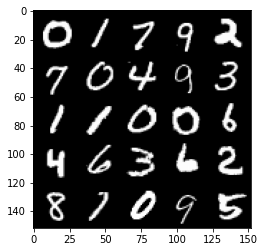

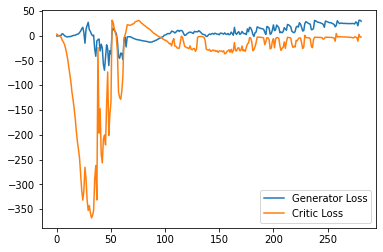

Step 5700: Generator loss: 28.87238182067871, critic loss: -2.7006991262435913


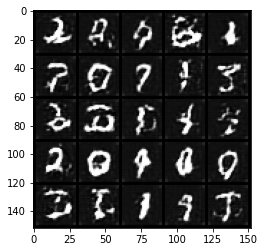

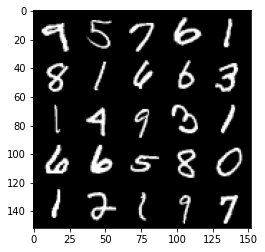

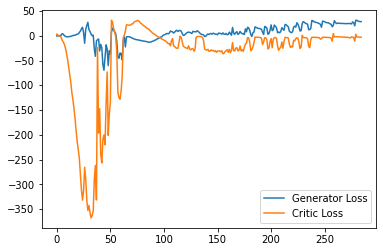

Step 5750: Generator loss: 27.261429691314696, critic loss: -5.572862731933594


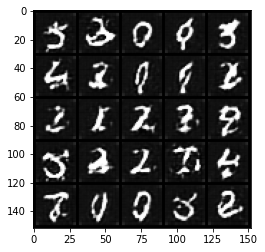

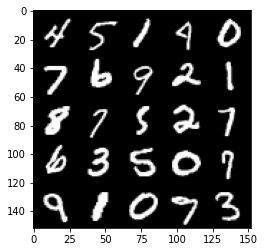

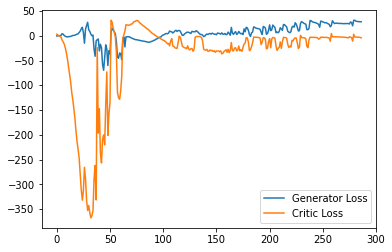

Step 5800: Generator loss: 31.852954750061034, critic loss: -3.1870773620605455


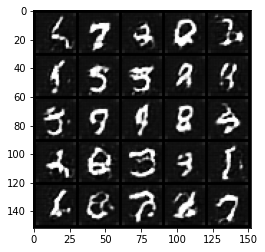

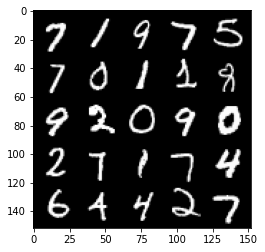

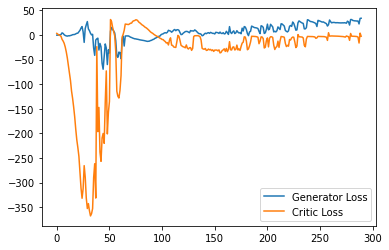

Step 5850: Generator loss: 32.11445487976074, critic loss: -2.548903063774109


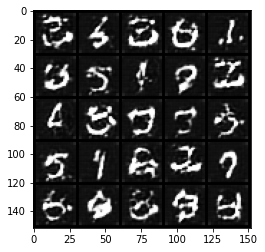

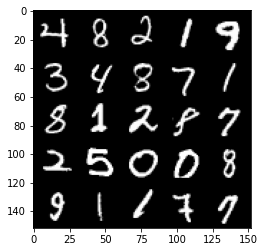

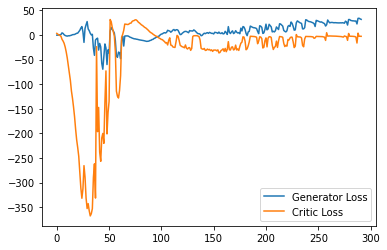

Step 5900: Generator loss: 29.950462532043456, critic loss: -2.814873232841491


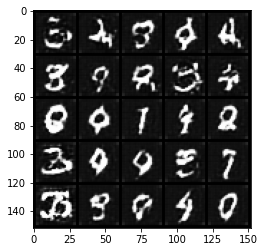

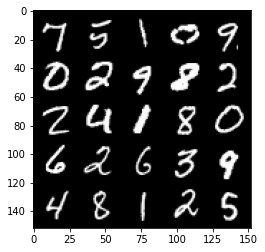

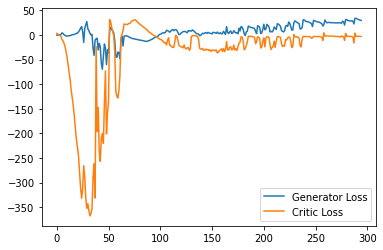

Step 5950: Generator loss: 28.37637351989746, critic loss: -4.122492625236511


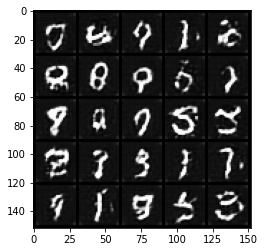

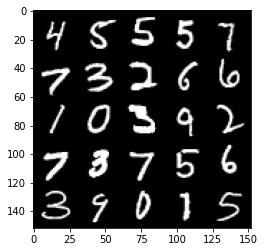

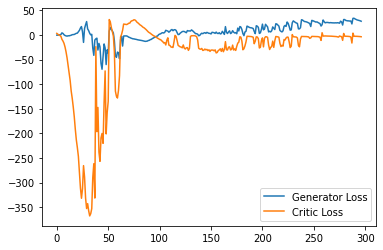

Step 6000: Generator loss: 27.239974784851075, critic loss: -9.263029566287996


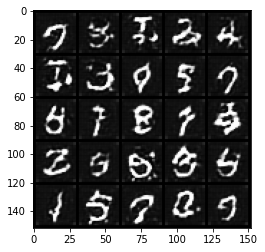

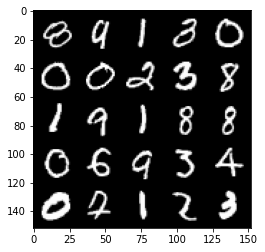

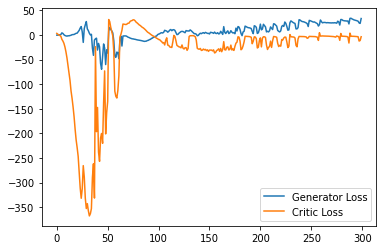

Step 6050: Generator loss: 24.536207375526427, critic loss: -12.543535648345946


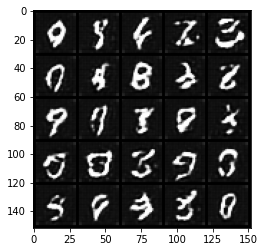

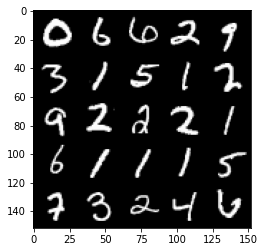

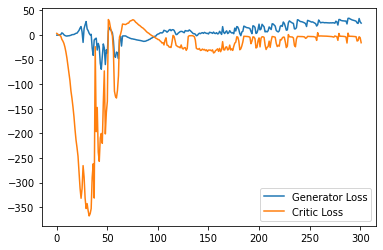

Step 6100: Generator loss: 26.432631130218507, critic loss: -14.481744628906247


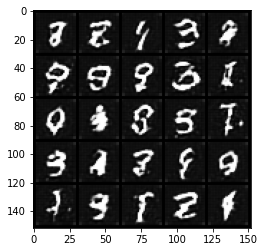

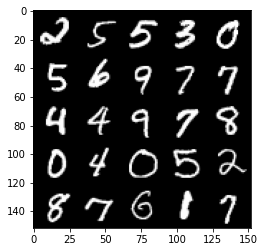

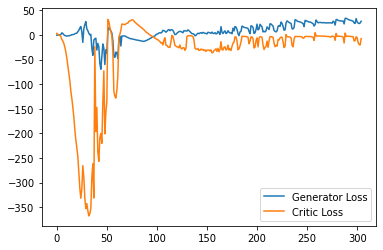

Step 6150: Generator loss: 40.474674987792966, critic loss: -3.7174386253356944


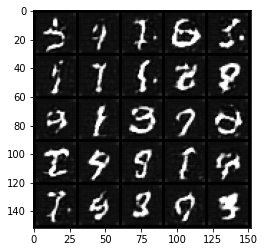

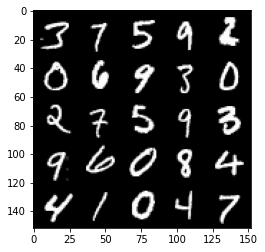

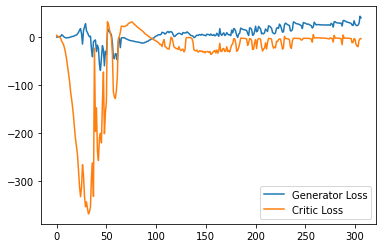

Step 6200: Generator loss: 28.274398231506346, critic loss: -16.64856291294098


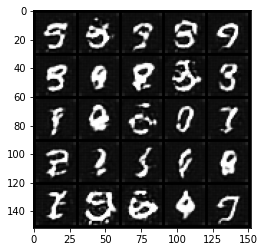

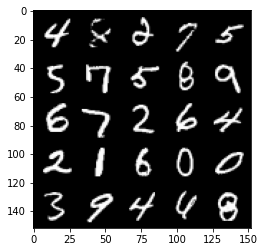

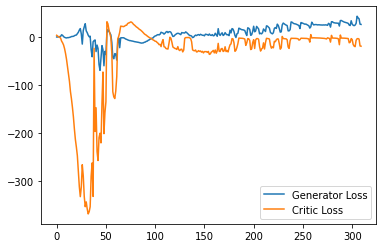

Step 6250: Generator loss: 27.877092552185058, critic loss: -17.81021675682068


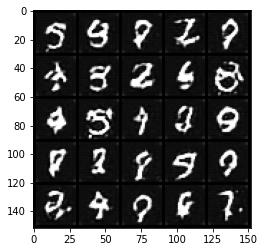

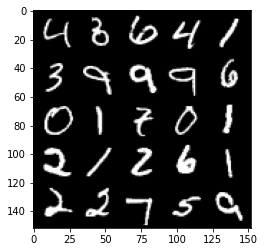

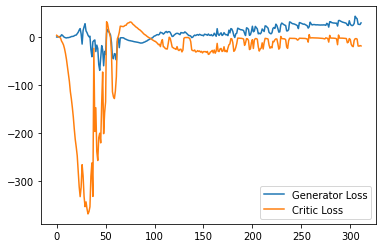

Step 6300: Generator loss: 43.114967308044434, critic loss: -1.2736454610824597


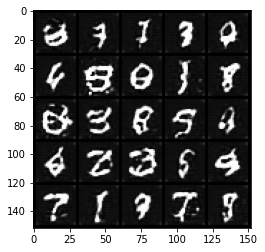

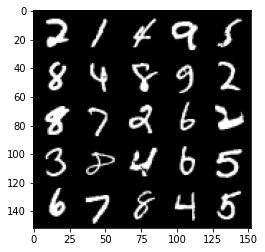

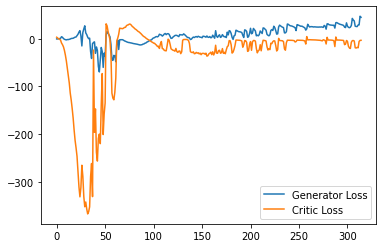

Step 6350: Generator loss: 42.101152877807614, critic loss: -3.188741976737976


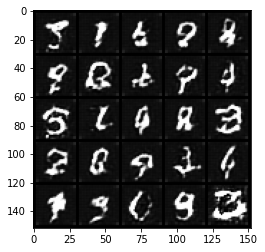

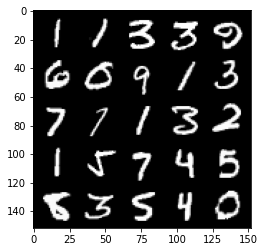

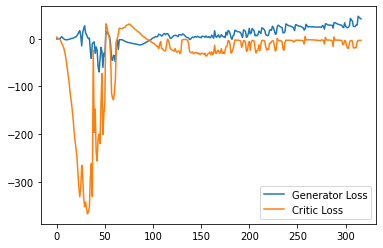

Step 6400: Generator loss: 35.47752082824707, critic loss: -10.97955871582031


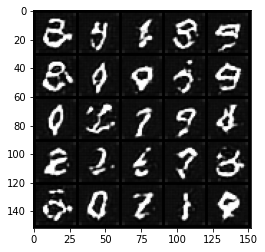

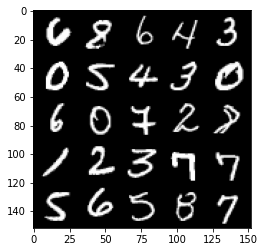

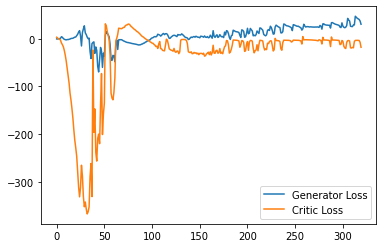

Step 6450: Generator loss: 37.78479473114014, critic loss: -6.67860054969788


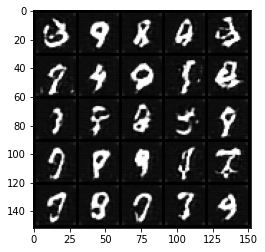

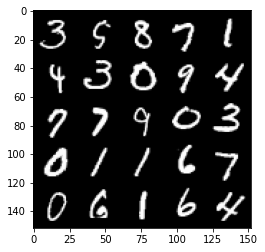

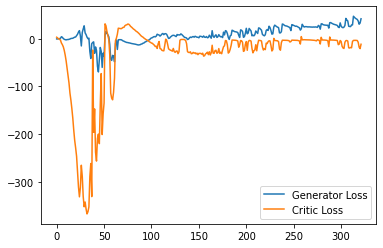

Step 6500: Generator loss: 43.03939407348633, critic loss: -2.8789469265937795


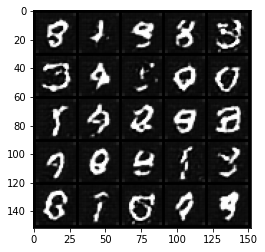

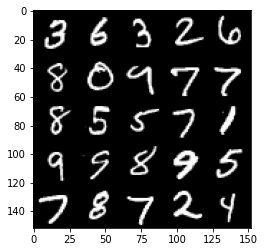

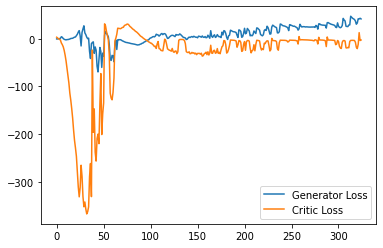

Step 6550: Generator loss: 40.2962739944458, critic loss: -9.92355634212494


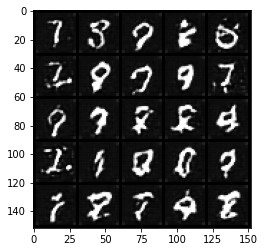

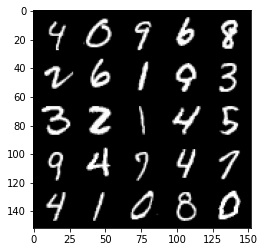

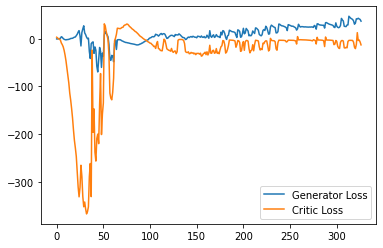

Step 6600: Generator loss: 38.403877105712894, critic loss: -15.101990274429323


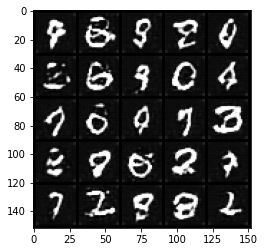

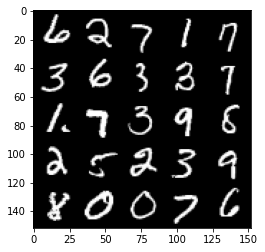

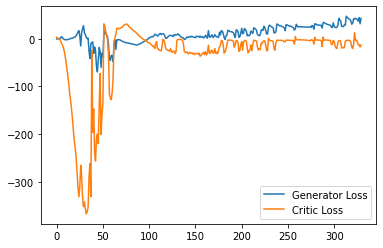

Step 6650: Generator loss: 42.185042266845706, critic loss: -15.081297292709348


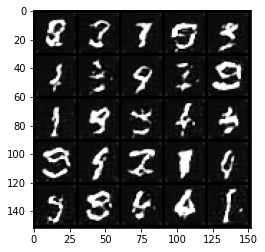

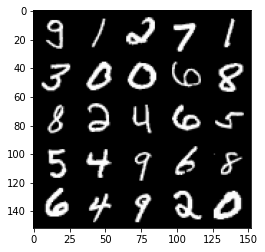

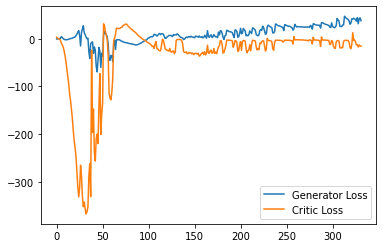

Step 6700: Generator loss: 40.396517486572264, critic loss: -14.594222041130065


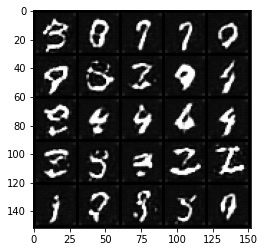

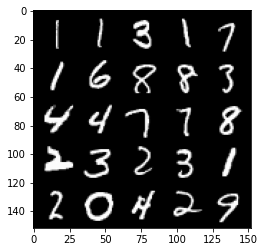

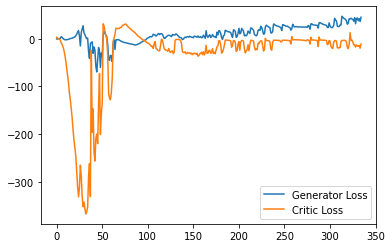

Step 6750: Generator loss: 41.12665917396546, critic loss: -8.623421461582184


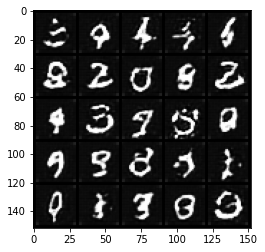

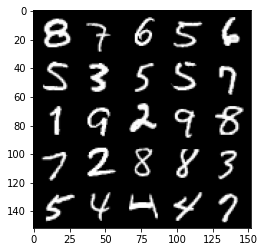

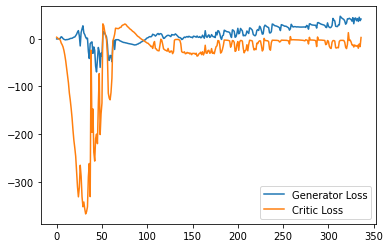

Step 6800: Generator loss: 41.853494033813476, critic loss: -14.823848366737366


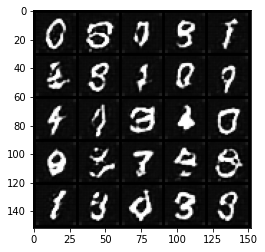

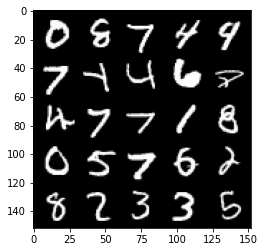

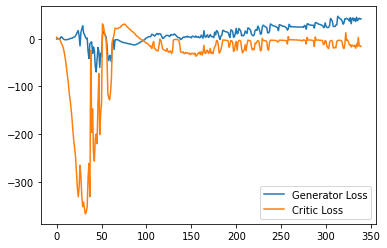

Step 6850: Generator loss: 53.01620361328125, critic loss: -6.356829864501954


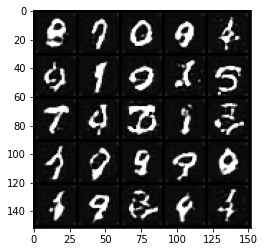

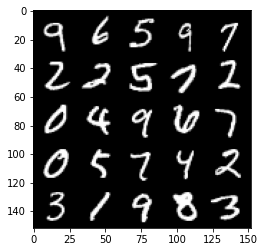

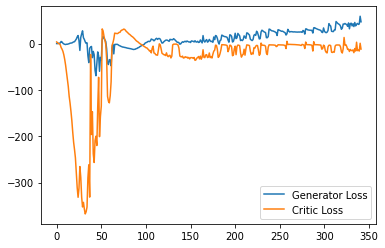

Step 6900: Generator loss: 48.96148056030273, critic loss: -9.625402211189272


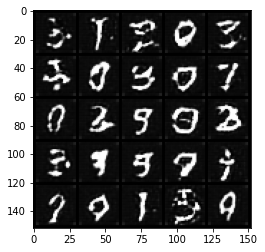

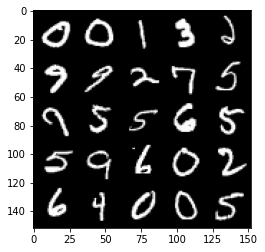

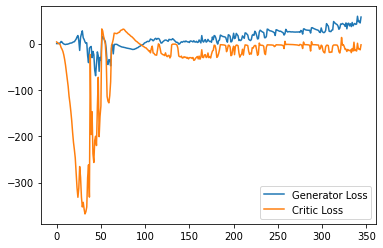

Step 6950: Generator loss: 50.52806625366211, critic loss: -10.873307925224305


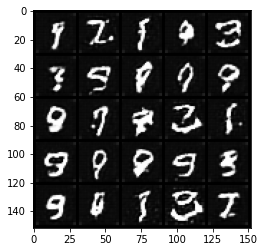

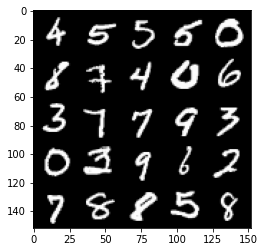

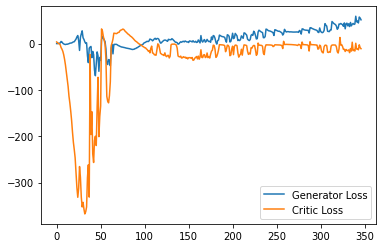

Step 7000: Generator loss: 43.69069137573242, critic loss: -17.857395426750184


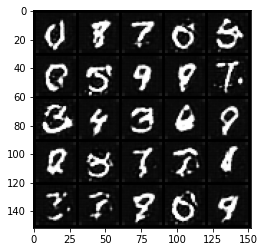

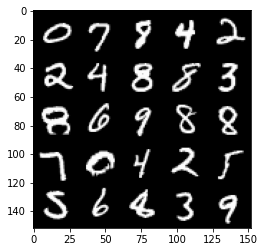

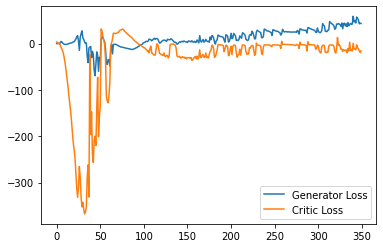

Step 7050: Generator loss: 47.9936100769043, critic loss: -15.630292775154116


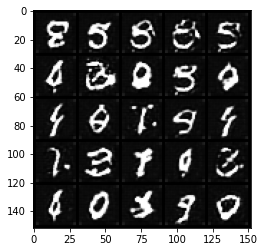

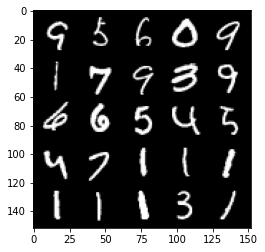

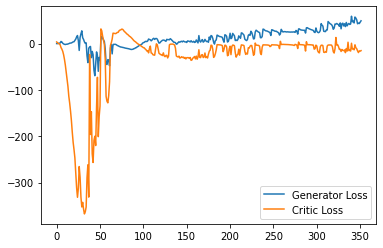

Step 7100: Generator loss: 51.80040969848633, critic loss: -13.553871851921082


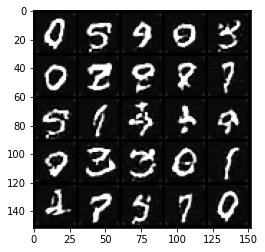

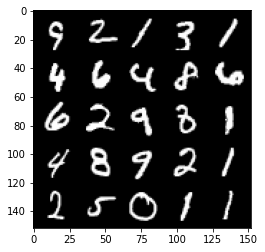

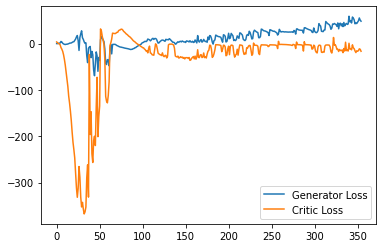

Step 7150: Generator loss: 62.16343475341797, critic loss: -0.3308000020980833


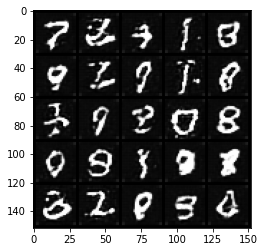

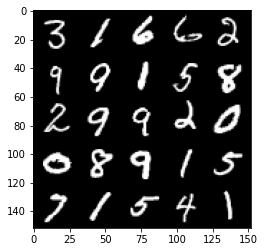

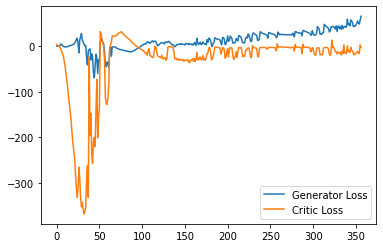

Step 7200: Generator loss: 62.40239845275879, critic loss: -2.9828094663619997


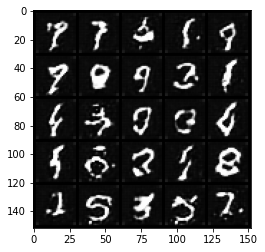

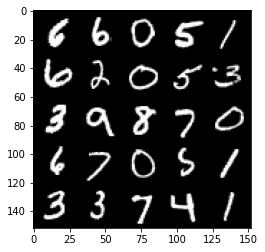

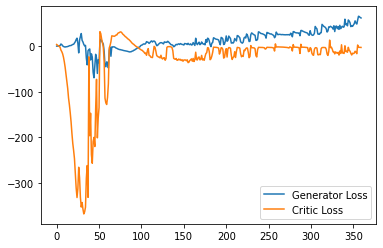

Step 7250: Generator loss: 59.8403475189209, critic loss: -3.6710507879257195


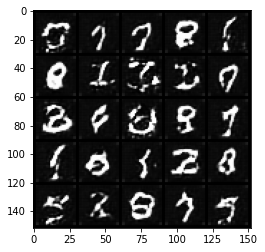

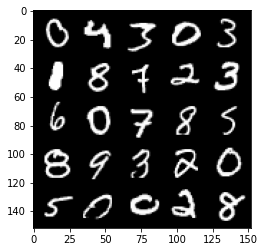

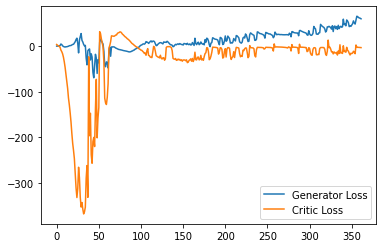

Step 7300: Generator loss: 54.09208206176758, critic loss: -13.612909838676451


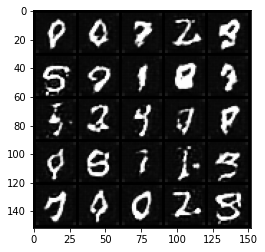

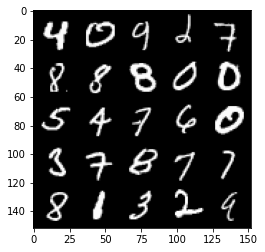

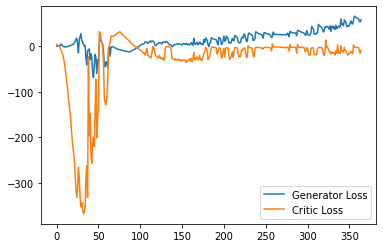

Step 7350: Generator loss: 54.239579315185544, critic loss: -13.38427633714676


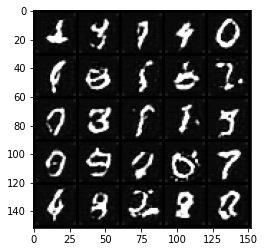

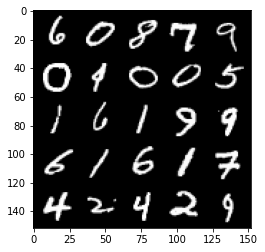

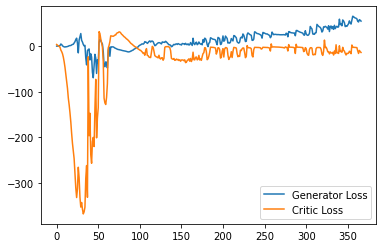

KeyboardInterrupt: 

In [40]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
